In [432]:
import os
import requests
import json
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

import datetime as dt
import hvplot.pandas
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt

import vectorbt as vbt
from vectorbt.generic.nb import nanmean_nb
from vectorbt.portfolio.nb import order_nb, sort_call_seq_nb
from vectorbt.portfolio.enums import SizeType, Direction

from numba import njit

import pytz
%matplotlib inline

In [2]:
load_dotenv()

True

In [433]:
# Set the variables for the Alpaca API and secret keys
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")

# Create the Alpaca tradeapi.REST object
api = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version="v2")

In [45]:
vbt.settings.data['alpaca']['key_id'] = alpaca_api_key
vbt.settings.data['alpaca']['secret_key'] = alpaca_secret_key

In [235]:
tickers = ['LOW', 'CMG', 'QSR', 'HLT', 'HHC', 'AAPL', 'BAC', 'KO', 'CVX', 'AXP', 'SPY', 'PG', 'PEP', 'JNJ', 'TSLA', 'TDOC', 'AMZN']

In [6]:
# Set timeframe to 1Day
# Format current date as ISO format
# Set both the start and end date at the date of your prior weekday
# This will give you the closing price of the previous trading day
# Alternatively you can use a start and end date of 2020-08-07
timeframe = "1Day"
start_date = pd.Timestamp("2017-08-01", tz="America/New_York").isoformat()
end_date = pd.Timestamp("2022-08-01", tz="America/New_York").isoformat()

In [7]:
ticker_data = api.get_bars(
    tickers,
    timeframe,
    start=start_date,
    end=end_date,
).df

In [8]:
ticker_data

,open,high,low,close,volume,trade_count,vwap,symbol
timestamp,,,,,,,,
2017-08-01 04:00:00+00:00,149.27,150.2200,148.4100,150.05,35380897,223054,151.670075,AAPL
2017-08-02 04:00:00+00:00,159.50,159.7500,156.1600,157.14,69957154,398107,157.903553,AAPL
2017-08-03 04:00:00+00:00,157.03,157.2100,155.0200,155.57,27097408,166577,155.916894,AAPL
2017-08-04 04:00:00+00:00,156.12,157.4000,155.6900,156.39,20559852,130145,156.445418,AAPL
2017-08-07 04:00:00+00:00,157.00,158.9200,156.6701,158.81,21871327,129566,158.015841,AAPL
...,...,...,...,...,...,...,...,...
2022-07-26 04:00:00+00:00,799.50,801.9299,768.7900,776.58,22273586,551723,782.001569,TSLA
2022-07-27 04:00:00+00:00,791.50,827.7768,785.3701,824.46,29275547,669212,811.026306,TSLA
2022-07-28 04:00:00+00:00,840.05,849.9000,818.4000,842.70,28240997,700681,837.389749,TSLA


In [9]:
ticker_data_pivoted = ticker_data.pivot(columns='symbol', values=['close', 'open']
)
ticker_data_pivoted.head()

close                                        \
symbol                       AAPL    AMZN    AXP    BAC     CMG     CVX   
timestamp                                                                 
2017-08-01 04:00:00+00:00  150.05  996.19  85.24  24.45  347.24  110.78   
2017-08-02 04:00:00+00:00  157.14  995.89  85.30  24.59  351.06  110.46   
2017-08-03 04:00:00+00:00  155.57  986.92  85.54  24.37  345.36  109.43   
2017-08-04 04:00:00+00:00  156.39  987.58  85.97  24.97  344.56  110.11   
2017-08-07 04:00:00+00:00  158.81  992.27  85.85  24.96  339.45  109.78   

                                                         ...   open          \
symbol                        HHC    HLT     JNJ     KO  ...    HLT     JNJ   
timestamp                                                ...                  
2017-08-01 04:00:00+00:00  125.91  62.77  132.51  45.70  ...  62.88  133.17   
2017-08-02 04:00:00+00:00  126.01  61.98  132.16  45.59  ...  62.69  132.08   
2017-08-03 04:00:00+00:00  126.09  62.13  133.35  45.67  ...  62.10  131.88   
2017-08-04 04:00:00+00:00  125.41  62.98  133.18  45.50  ...  62.31  133.74   
2017-08-07 04:00:00+00:00  125.77  63.77  132.86  45.64  ...  63.34  133.09   

                                                                             \
symbol                        KO    LOW     PEP     PG    QSR     SPY  TDOC   
timestamp                                                                     
2017-08-01 04:00:00+00:00  45.97  77.41  116.69  91.00  59.95  247.45  32.9   
2017-08-02 04:00:00+00:00  45.56  77.57  115.73  90.97  58.15  247.47  32.5   
2017-08-03 04:00:00+00:00  45.67  78.07  115.73  90.96  60.40  247.31  31.0   
2017-08-04 04:00:00+00:00  45.67  78.46  116.32  90.70  61.27  247.52  30.5   
2017-08-07 04:00:00+00:00  45.52  78.50  116.45  90.65  62.29  247.50  30.8   

                                   
symbol                       TSLA  
timestamp                          
2017-08-01 04:00:00+00:00  322.69  
2017-08-02 04:00:00+00:00  318.94  
2017-08-03 04:00:00+00:00  346.80  
2017-08-04 04:00:00+00:00  347.00  
2017-08-07 04:00:00+00:00  357.00  

[5 rows x 34 columns]

In [10]:
ticker_data_pivoted = ticker_data_pivoted.fillna(method='bfill')
ticker_data_pivoted.tail()

close                                          \
symbol                       AAPL    AMZN     AXP    BAC      CMG     CVX   
timestamp                                                                   
2022-07-26 04:00:00+00:00  151.60  114.81  149.83  33.05  1316.43  147.32   
2022-07-27 04:00:00+00:00  156.79  120.97  151.63  33.59  1510.00  149.26   
2022-07-28 04:00:00+00:00  157.35  122.28  152.14  33.32  1538.88  150.39   
2022-07-29 04:00:00+00:00  162.51  134.95  154.02  33.81  1564.22  163.78   
2022-08-01 04:00:00+00:00  161.51  135.39  153.33  33.71  1557.38  160.51   

                                                         ...    open          \
symbol                       HHC     HLT     JNJ     KO  ...     HLT     JNJ   
timestamp                                                ...                   
2022-07-26 04:00:00+00:00  69.81  120.22  173.68  63.21  ...  121.29  172.56   
2022-07-27 04:00:00+00:00  71.32  129.25  173.20  63.01  ...  127.31  172.63   
2022-07-28 04:00:00+00:00  71.46  128.00  174.20  64.06  ...  129.22  173.40   
2022-07-29 04:00:00+00:00  70.89  128.07  174.52  64.17  ...  127.84  173.79   
2022-08-01 04:00:00+00:00  70.08  128.69  173.91  64.52  ...  127.03  174.17   

                                                                         \
symbol                        KO     LOW     PEP      PG    QSR     SPY   
timestamp                                                                 
2022-07-26 04:00:00+00:00  62.53  188.43  170.57  142.92  51.17  393.84   
2022-07-27 04:00:00+00:00  62.88  188.60  170.49  143.95  51.21  394.43   
2022-07-28 04:00:00+00:00  62.92  187.85  171.87  145.81  52.10  401.84   
2022-07-29 04:00:00+00:00  63.71  189.81  173.85  140.44  53.14  407.70   
2022-08-01 04:00:00+00:00  64.10  191.55  174.55  138.67  53.27  409.16   

                                          
symbol                      TDOC    TSLA  
timestamp                                 
2022-07-26 04:00:00+00:00  41.71  799.50  
2022-07-27 04:00:00+00:00  41.21  791.50  
2022-07-28 04:00:00+00:00  35.35  840.05  
2022-07-29 04:00:00+00:00  35.08  842.31  
2022-08-01 04:00:00+00:00  36.52  904.00  

[5 rows x 34 columns]

In [360]:
ticker_daily_returns_df = ticker_data_pivoted["close"].pct_change().dropna()
ticker_daily_returns_df.tail()

symbol,AAPL,AMZN,AXP,BAC,CMG,CVX,HHC,HLT,JNJ,KO,LOW,PEP,PG,QSR,SPY,TDOC,TSLA
timestamp,,,,,,,,,,,,,,,,,
2022-07-26 04:00:00+00:00,-0.008826,-0.052254,-0.025749,-0.020160,-0.009361,-0.007812,-0.000143,-0.016122,0.007074,0.016401,-0.031828,0.011657,0.001945,-0.010893,-0.011831,-0.044914,-0.035664
2022-07-27 04:00:00+00:00,0.034235,0.053654,0.012014,0.016339,0.147042,0.013169,0.021630,0.075112,-0.002764,-0.003164,0.006999,-0.001397,0.009496,0.023599,0.025966,0.075890,0.061655
2022-07-28 04:00:00+00:00,0.003572,0.010829,0.003363,-0.008038,0.019126,0.007571,0.001963,-0.009671,0.005774,0.016664,0.004634,0.018940,0.016616,0.020557,0.012542,-0.176688,0.022124
2022-07-29 04:00:00+00:00,0.032793,0.103615,0.012357,0.014706,0.016467,0.089035,-0.007976,0.000547,0.001837,0.001717,0.003826,0.000686,-0.061799,0.009224,0.014579,0.035112,0.057850
2022-08-01 04:00:00+00:00,-0.006153,0.003260,-0.004480,-0.002958,-0.004373,-0.019966,-0.011426,0.004841,-0.003495,0.005454,0.013366,0.011374,0.028724,0.015855,-0.002961,-0.001085,0.000426


<AxesSubplot:title={'center':'Ticker PCT Change'}, xlabel='timestamp'>

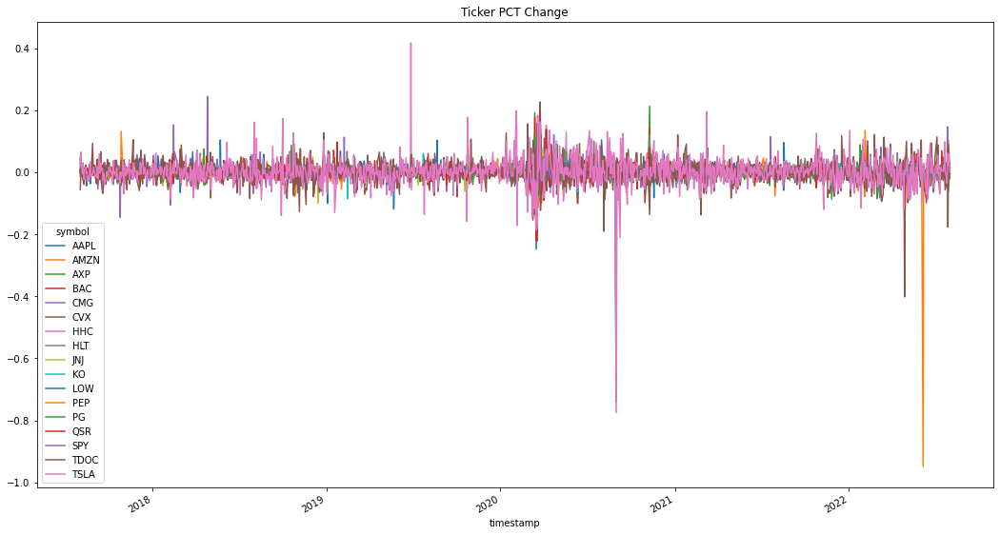

In [361]:
ticker_daily_returns_df.plot( title="Ticker PCT Change", figsize = (18,10))

In [362]:
cumulative_returns_df = (1 + ticker_daily_returns_df).cumprod()
cumulative_returns_df.tail()

symbol,AAPL,AMZN,AXP,BAC,CMG,CVX,HHC,HLT,JNJ,KO,LOW,PEP,PG,QSR,SPY,TDOC,TSLA
timestamp,,,,,,,,,,,,,,,,,
2022-07-26 04:00:00+00:00,1.010330,0.115249,1.757743,1.351738,3.791124,1.329843,0.554444,1.915246,1.310694,1.383151,2.423230,1.482315,1.583644,0.858228,1.580503,1.234716,2.430078
2022-07-27 04:00:00+00:00,1.044918,0.121433,1.778860,1.373824,4.348577,1.347355,0.566436,2.059105,1.307071,1.378775,2.440190,1.480245,1.598683,0.878481,1.621543,1.328418,2.579904
2022-07-28 04:00:00+00:00,1.048650,0.122748,1.784843,1.362781,4.431747,1.357556,0.567548,2.039191,1.314618,1.401751,2.451497,1.508282,1.625247,0.896540,1.641881,1.093702,2.636981
2022-07-29 04:00:00+00:00,1.083039,0.135466,1.806898,1.382822,4.504723,1.478426,0.563021,2.040306,1.317033,1.404158,2.460876,1.509317,1.524808,0.904810,1.665818,1.132104,2.789530
2022-08-01 04:00:00+00:00,1.076375,0.135908,1.798803,1.378732,4.485025,1.448908,0.556588,2.050183,1.312429,1.411816,2.493768,1.526484,1.568606,0.919156,1.660885,1.130876,2.790719


<AxesSubplot:title={'center':'Ticker Cumulative Returns'}, xlabel='timestamp'>

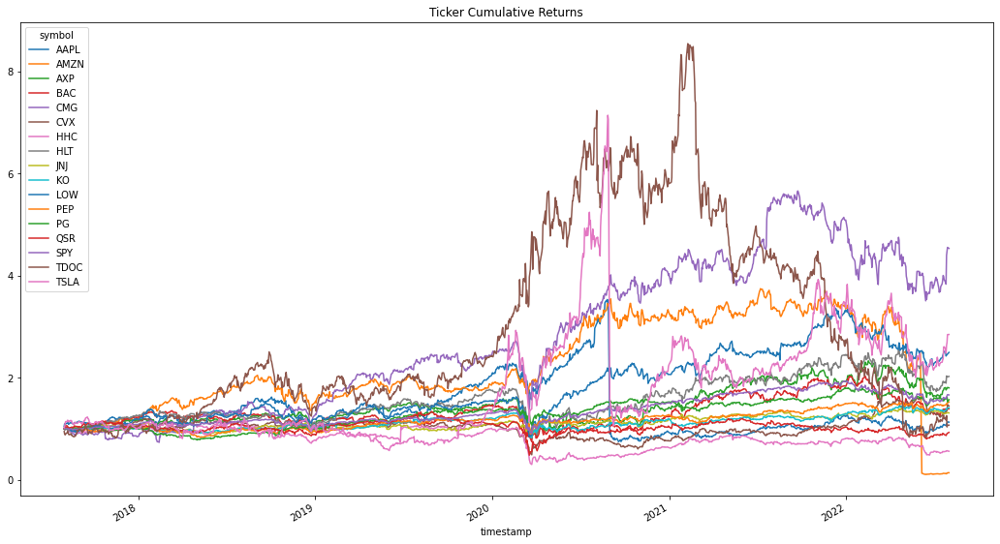

In [14]:
cumulative_returns_df.plot( title="Ticker Cumulative Returns", figsize = (18,10))

In [15]:
tickers_daily_std = ticker_daily_returns_df.std().sort_values()
tickers_daily_std

symbol
SPY     0.012947
JNJ     0.013027
KO      0.013363
PG      0.013585
PEP     0.013748
QSR     0.020042
LOW     0.020808
HLT     0.021262
BAC     0.021939
CVX     0.021940
AXP     0.023042
CMG     0.024782
HHC     0.027180
AAPL    0.029160
AMZN    0.034339
TDOC    0.039594
TSLA    0.045638
dtype: float64

In [16]:
tickers_daily_std_annualized = tickers_daily_std * np.sqrt(252)
tickers_daily_std_annualized

symbol
SPY     0.205530
JNJ     0.206793
KO      0.212137
PG      0.215654
PEP     0.218241
QSR     0.318152
LOW     0.330321
HLT     0.337520
BAC     0.348264
CVX     0.348279
AXP     0.365780
CMG     0.393398
HHC     0.431461
AAPL    0.462898
AMZN    0.545118
TDOC    0.628537
TSLA    0.724486
dtype: float64

<AxesSubplot:title={'center':'21 Day Rolling Standard Deviations'}, xlabel='timestamp'>

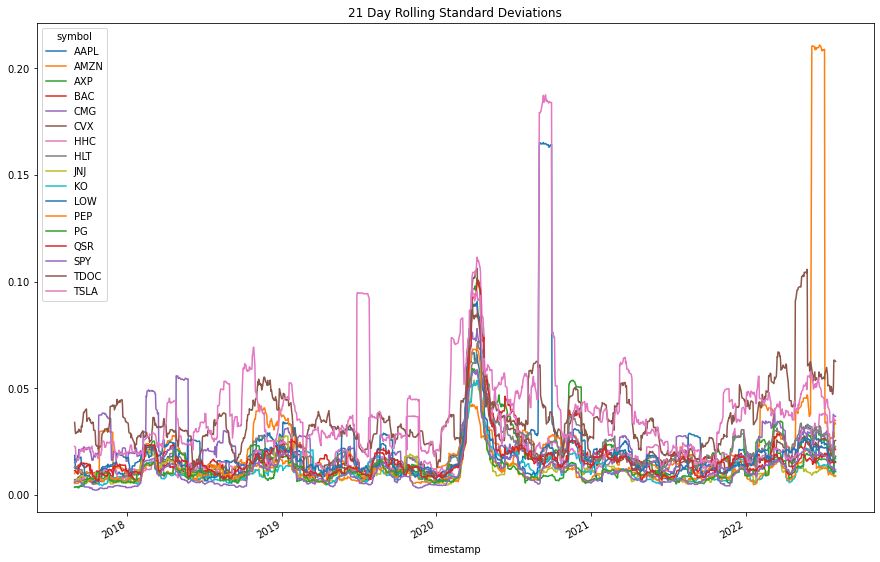

In [17]:
tickers_daily_rolling_std_dev = ticker_daily_returns_df.rolling(window=21).std()
tickers_daily_rolling_std_dev.plot(figsize=(15,10), title="21 Day Rolling Standard Deviations")

In [18]:
annual_average_return = ticker_daily_returns_df.mean() * 252
annual_average_return.sort_values()

symbol
HHC    -0.026566
QSR     0.035558
AMZN    0.064420
JNJ     0.075336
KO      0.091214
PEP     0.108012
PG      0.113187
SPY     0.122912
BAC     0.125847
CVX     0.134850
AXP     0.183523
HLT     0.198086
AAPL    0.198466
TDOC    0.217174
LOW     0.238867
CMG     0.378789
TSLA    0.554303
dtype: float64

In [19]:
sharpe_ratio = annual_average_return / tickers_daily_std_annualized
sharpe_ratio.sort_values()

symbol
HHC    -0.061573
QSR     0.111763
AMZN    0.118177
TDOC    0.345522
BAC     0.361357
JNJ     0.364305
CVX     0.387190
AAPL    0.428747
KO      0.429978
PEP     0.494922
AXP     0.501730
PG      0.524857
HLT     0.586886
SPY     0.598022
LOW     0.723137
TSLA    0.765098
CMG     0.962863
dtype: float64

In [359]:
sharpe_ratio.hvplot.bar(title = "Sharpe Ratios")

:Bars   [symbol]   (0)

In [369]:
tickers_rolling_var = ticker_daily_returns_df.rolling(window=60).var().dropna()
tickers_rolling_var.head()

symbol,AAPL,AMZN,AXP,BAC,CMG,CVX,HHC,HLT,JNJ,KO,LOW,PEP,PG,QSR,SPY,TDOC,TSLA
timestamp,,,,,,,,,,,,,,,,,
2017-10-25 04:00:00+00:00,0.000151,0.000095,0.000048,0.000160,0.000704,0.000052,0.000077,0.000088,0.000075,0.000029,0.000144,0.000042,0.000056,0.000128,0.000019,0.000902,0.000455
2017-10-26 04:00:00+00:00,0.000114,0.000095,0.000056,0.000160,0.000707,0.000052,0.000077,0.000087,0.000075,0.000029,0.000144,0.000043,0.000057,0.000144,0.000019,0.000851,0.000449
2017-10-27 04:00:00+00:00,0.000133,0.000385,0.000056,0.000158,0.000708,0.000080,0.000078,0.000089,0.000074,0.000029,0.000147,0.000042,0.000058,0.000141,0.000020,0.000870,0.000380
2017-10-30 04:00:00+00:00,0.000141,0.000386,0.000057,0.000151,0.000717,0.000080,0.000078,0.000088,0.000077,0.000029,0.000150,0.000043,0.000059,0.000134,0.000021,0.000880,0.000365
2017-10-31 04:00:00+00:00,0.000140,0.000387,0.000057,0.000152,0.000719,0.000083,0.000078,0.000087,0.000077,0.000029,0.000151,0.000043,0.000057,0.000134,0.000021,0.000887,0.000388


In [364]:
tickers_rolling_covariance =ticker_daily_returns_df.rolling(window=60).cov().dropna()
tickers_rolling_covariance

symbol                                AAPL      AMZN       AXP       BAC  \
timestamp                 symbol                                           
2017-10-25 04:00:00+00:00 AAPL    0.000151  0.000063  0.000033  0.000062   
                          AMZN    0.000063  0.000095  0.000021  0.000056   
                          AXP     0.000033  0.000021  0.000048  0.000055   
                          BAC     0.000062  0.000056  0.000055  0.000160   
                          CMG     0.000051  0.000068  0.000036  0.000063   
...                                    ...       ...       ...       ...   
2022-08-01 04:00:00+00:00 PG      0.000163  0.000129  0.000110  0.000101   
                          QSR     0.000298  0.000442  0.000290  0.000195   
                          SPY     0.000380  0.000450  0.000341  0.000265   
                          TDOC    0.000911  0.001401  0.000776  0.000569   
                          TSLA    0.000942  0.001009  0.000797  0.000548   

symbol                                 CMG       CVX       HHC       HLT  \
timestamp                 symbol                                           
2017-10-25 04:00:00+00:00 AAPL    0.000051  0.000012  0.000005  0.000012   
                          AMZN    0.000068  0.000012  0.000021  0.000034   
                          AXP     0.000036  0.000004  0.000010  0.000020   
                          BAC     0.000063  0.000025  0.000019  0.000042   
                          CMG     0.000704  0.000069  0.000073  0.000030   
...                                    ...       ...       ...       ...   
2022-08-01 04:00:00+00:00 PG      0.000146 -0.000017  0.000179  0.000097   
                          QSR     0.000380  0.000144  0.000386  0.000326   
                          SPY     0.000414  0.000233  0.000409  0.000374   
                          TDOC    0.001156  0.000289  0.001116  0.001032   
                          TSLA    0.001017  0.000446  0.000851  0.000862   

symbol                                 JNJ        KO       LOW       PEP  \
timestamp                 symbol                                           
2017-10-25 04:00:00+00:00 AAPL    0.000012  0.000003 -0.000003  0.000019   
                          AMZN    0.000012  0.000004  0.000016  0.000015   
                          AXP     0.000001  0.000003 -0.000002  0.000007   
                          BAC    -0.000006 -0.000007  0.000010 -0.000005   
                          CMG     0.000012  0.000022  0.000055  0.000033   
...                                    ...       ...       ...       ...   
2022-08-01 04:00:00+00:00 PG      0.000114  0.000190  0.000135  0.000184   
                          QSR     0.000060  0.000112  0.000195  0.000109   
                          SPY     0.000087  0.000137  0.000239  0.000139   
                          TDOC    0.000144  0.000136  0.000706  0.000183   
                          TSLA    0.000101  0.000165  0.000569  0.000232   

symbol                                  PG       QSR       SPY      TDOC  \
timestamp                 symbol                                           
2017-10-25 04:00:00+00:00 AAPL    0.000015  0.000030  0.000029  0.000010   
                          AMZN    0.000009  0.000043  0.000029  0.000065   
                          AXP     0.000005  0.000010  0.000017 -0.000004   
                          BAC    -0.000019  0.000035  0.000038  0.000065   
                          CMG     0.000008 -0.000006  0.000035  0.000083   
...                                    ...       ...       ...       ...   
2022-08-01 04:00:00+00:00 PG      0.000317  0.000115  0.000129  0.000121   
                          QSR     0.000115  0.000282  0.000231  0.000537   
                          SPY     0.000129  0.000231  0.000293  0.000662   
                          TDOC    0.000121  0.000537  0.000662  0.003430   
                          TSLA    0.000146  0.000511  0.000653  0.001766   

symbol                                TSLA  

In [365]:
spy_rolling_var = pd.DataFrame(ticker_daily_returns_df['SPY'].rolling(window=60).var().dropna())
spy_rolling_var

,SPY
timestamp,
2017-10-25 04:00:00+00:00,0.000019
2017-10-26 04:00:00+00:00,0.000019
2017-10-27 04:00:00+00:00,0.000020
2017-10-30 04:00:00+00:00,0.000021
2017-10-31 04:00:00+00:00,0.000021
...,...
2022-07-26 04:00:00+00:00,0.000313
2022-07-27 04:00:00+00:00,0.000303
2022-07-28 04:00:00+00:00,0.000305


In [384]:
beta_tickers_60 = tickers_rolling_covariance/ tickers_rolling_var
beta_tickers_60

symbol                                AAPL      AMZN       AXP       BAC  \
timestamp                 symbol                                           
2017-10-25 04:00:00+00:00 AAPL    1.000000  0.661702  0.692330  0.383716   
                          AMZN    0.415486  1.000000  0.436793  0.350663   
                          AXP     0.220504  0.221557  1.000000  0.341163   
                          BAC     0.408250  0.594171  1.139656  1.000000   
                          CMG     0.340823  0.718161  0.760300  0.395971   
...                                    ...       ...       ...       ...   
2022-08-01 04:00:00+00:00 PG      0.267962  0.007889  0.186742  0.231039   
                          QSR     0.489612  0.027097  0.493958  0.445860   
                          SPY     0.624836  0.027575  0.580144  0.606191   
                          TDOC    1.497235  0.085856  1.321165  1.302685   
                          TSLA    1.547854  0.061827  1.356811  1.254456   

symbol                                 CMG       CVX       HHC       HLT  \
timestamp                 symbol                                           
2017-10-25 04:00:00+00:00 AAPL    0.072993  0.231065  0.064647  0.131714   
                          AMZN    0.096576  0.223641  0.275918  0.385312   
                          AXP     0.051861  0.079709  0.126272  0.231611   
                          BAC     0.090226  0.480556  0.249722  0.483426   
                          CMG     1.000000  1.331028  0.946645  0.343009   
...                                    ...       ...       ...       ...   
2022-08-01 04:00:00+00:00 PG      0.142426 -0.026357  0.197950  0.118948   
                          QSR     0.369124  0.222459  0.425594  0.400329   
                          SPY     0.402670  0.358966  0.451532  0.460241   
                          TDOC    1.124278  0.444865  1.232294  1.268247   
                          TSLA    0.988529  0.688414  0.939241  1.059891   

symbol                                 JNJ        KO       LOW       PEP  \
timestamp                 symbol                                           
2017-10-25 04:00:00+00:00 AAPL    0.155110  0.115526 -0.020626  0.462100   
                          AMZN    0.162473  0.143320  0.111343  0.354742   
                          AXP     0.018378  0.104529 -0.016709  0.161909   
                          BAC    -0.085676 -0.255632  0.067980 -0.127760   
                          CMG     0.162434  0.771677  0.382451  0.782791   
...                                    ...       ...       ...       ...   
2022-08-01 04:00:00+00:00 PG      0.988517  0.832634  0.319783  0.972970   
                          QSR     0.519123  0.490555  0.461945  0.579384   
                          SPY     0.749370  0.600824  0.565812  0.736238   
                          TDOC    1.245036  0.594074  1.672802  0.970641   
                          TSLA    0.876809  0.720597  1.349550  1.229929   

symbol                                  PG       QSR       SPY      TDOC  \
timestamp                 symbol                                           
2017-10-25 04:00:00+00:00 AAPL    0.258960  0.234330  1.498166  0.011469   
                          AMZN    0.165876  0.333146  1.511057  0.071527   
                          AXP     0.080703  0.077883  0.878002 -0.004566   
                          BAC    -0.331527  0.273299  1.968900  0.071766   
                          CMG     0.143791 -0.043644  1.796434  0.091808   
...                                    ...       ...       ...       ...   
2022-08-01 04:00:00+00:00 PG      1.000000  0.409036  0.442399  0.035209   
                          QSR     0.362875  1.000000  0.790745  0.156467   
                          SPY     0.407691  0.821406  1.000000  0.192919   
                          TDOC    0.380485  1.905935  2.262232  1.000000   
                          TSLA    0.458891  1.814456  2.232881  0.514768   

symbol                                TSLA  

In [386]:
rolling_beta = vbt.rolling_beta_nb(
    returns = ticker_daily_returns_df,
    window = 60,
    minp,
    benchmark_rets
).df

SyntaxError: positional argument follows keyword argument (2323881371.py, line 6)

Section 3: Backtesting Analysis

In this section we will test our model over the past 5 years using Vector BT. Also, we will compare the cumulative returns to a different strategy of trading the crossover moving average (CMA). 

In [118]:
#Let's first apply the CMA approach to one stock, Tesla.
tsla_ticker = 'TSLA'

In [119]:
#Vector BT works with Alpaca data so we can use our API to get data for just TSLA. 
tsla_data = api.get_bars(
    tsla_ticker,
    timeframe,
    start=start_date,
    end=end_date,
).df

In [120]:
#Boolean values will be returned when the module looks at the daily returns.
#Here we choose windows of 10 and 20 days. 
fast_ma = vbt.MA.run(tsla_data, 10, short_name='fast')
slow_ma = vbt.MA.run(tsla_data, 20, short_name='slow')

entries = fast_ma.ma_crossed_above(slow_ma)
entries

fast_window                   10                                          \
slow_window                   20                                           
                            open   high    low  close volume trade_count   
timestamp                                                                  
2017-08-01 04:00:00+00:00  False  False  False  False  False       False   
2017-08-02 04:00:00+00:00  False  False  False  False  False       False   
2017-08-03 04:00:00+00:00  False  False  False  False  False       False   
2017-08-04 04:00:00+00:00  False  False  False  False  False       False   
2017-08-07 04:00:00+00:00  False  False  False  False  False       False   
...                          ...    ...    ...    ...    ...         ...   
2022-07-26 04:00:00+00:00  False  False  False  False  False       False   
2022-07-27 04:00:00+00:00  False  False  False  False  False       False   
2022-07-28 04:00:00+00:00  False  False  False  False  False       False   
2022-07-29 04:00:00+00:00  False  False  False  False   True        True   
2022-08-01 04:00:00+00:00  False  False  False  False  False       False   

fast_window                       
slow_window                       
                            vwap  
timestamp                         
2017-08-01 04:00:00+00:00  False  
2017-08-02 04:00:00+00:00  False  
2017-08-03 04:00:00+00:00  False  
2017-08-04 04:00:00+00:00  False  
2017-08-07 04:00:00+00:00  False  
...                          ...  
2022-07-26 04:00:00+00:00  False  
2022-07-27 04:00:00+00:00  False  
2022-07-28 04:00:00+00:00  False  
2022-07-29 04:00:00+00:00  False  
2022-08-01 04:00:00+00:00  False  

[1259 rows x 7 columns]

In [121]:
exits = fast_ma.ma_crossed_below(slow_ma)
exits

fast_window                   10                                          \
slow_window                   20                                           
                            open   high    low  close volume trade_count   
timestamp                                                                  
2017-08-01 04:00:00+00:00  False  False  False  False  False       False   
2017-08-02 04:00:00+00:00  False  False  False  False  False       False   
2017-08-03 04:00:00+00:00  False  False  False  False  False       False   
2017-08-04 04:00:00+00:00  False  False  False  False  False       False   
2017-08-07 04:00:00+00:00  False  False  False  False  False       False   
...                          ...    ...    ...    ...    ...         ...   
2022-07-26 04:00:00+00:00  False  False  False  False  False       False   
2022-07-27 04:00:00+00:00  False  False  False  False   True       False   
2022-07-28 04:00:00+00:00  False  False  False  False  False       False   
2022-07-29 04:00:00+00:00  False  False  False  False  False       False   
2022-08-01 04:00:00+00:00  False  False  False  False  False       False   

fast_window                       
slow_window                       
                            vwap  
timestamp                         
2017-08-01 04:00:00+00:00  False  
2017-08-02 04:00:00+00:00  False  
2017-08-03 04:00:00+00:00  False  
2017-08-04 04:00:00+00:00  False  
2017-08-07 04:00:00+00:00  False  
...                          ...  
2022-07-26 04:00:00+00:00  False  
2022-07-27 04:00:00+00:00  False  
2022-07-28 04:00:00+00:00  False  
2022-07-29 04:00:00+00:00  False  
2022-08-01 04:00:00+00:00  False  

[1259 rows x 7 columns]

In [122]:
pf = vbt.Portfolio.from_signals(tsla_data, entries, exits)
pf.total_return()

fast_window  slow_window             
10           20           open           1.675130
                          high           1.016264
                          low            1.370469
                          close          1.773444
                          volume        -0.999576
                          trade_count   -0.999995
                          vwap           1.270016
Name: total_return, dtype: float64

In [115]:
#We can print the stats from the CMA returns of 5 years of trading the 10 and 20 day moving averages.
pf[(10, 20)].stats()

/var/folders/1g/jxl_865n099528slbkpdy3_c0000gn/T/ipykernel_92896/3022195350.py:1: UserWarning: Object has multiple columns. Aggregating using <function mean at 0x7fb6724deb80>. Pass column to select a single column/group.
  pf[(10, 20)].stats()


Start                          2017-08-01 04:00:00+00:00
End                            2022-08-01 04:00:00+00:00
Period                                1259 days 00:00:00
Start Value                                        100.0
End Value                                     241.708267
Total Return [%]                              141.708267
Benchmark Return [%]                          179.608454
Max Gross Exposure [%]                             100.0
Total Fees Paid                                 7.834173
Max Drawdown [%]                                84.12565
Max Drawdown Duration                  532 days 21:36:00
Total Trades                                        33.4
Total Closed Trades                                 32.4
Total Open Trades                                    1.0
Open Trade PnL                                 42.197181
Win Rate [%]                                   46.019028
Best Trade [%]                                143.853632
Worst Trade [%]                

In [74]:
#Now let's get data for our entire portfolio.
pf_4_tickers = ['TSLA', 'HLT', 'LOW', 'CMG', 'SPY']

In [75]:
pf_4_data = api.get_bars(
    pf_4_tickers,
    timeframe,
    start= start_date,
    end= end_date,
).df
pf_4_data

,open,high,low,close,volume,trade_count,vwap,symbol
timestamp,,,,,,,,
2017-08-01 04:00:00+00:00,344.08,347.7400,340.6310,347.24,897554,12358,344.922940,CMG
2017-08-02 04:00:00+00:00,348.00,352.4150,346.1300,351.06,995946,13569,349.525745,CMG
2017-08-03 04:00:00+00:00,351.84,355.4800,345.1500,345.36,922606,13494,350.140666,CMG
2017-08-04 04:00:00+00:00,344.43,345.3800,339.2100,344.56,829772,10980,342.745602,CMG
2017-08-07 04:00:00+00:00,344.43,345.7300,336.9100,339.45,961237,14426,339.439124,CMG
...,...,...,...,...,...,...,...,...
2022-07-26 04:00:00+00:00,799.50,801.9299,768.7900,776.58,22273586,551723,782.001569,TSLA
2022-07-27 04:00:00+00:00,791.50,827.7768,785.3701,824.46,29275547,669212,811.026306,TSLA
2022-07-28 04:00:00+00:00,840.05,849.9000,818.4000,842.70,28240997,700681,837.389749,TSLA


In [77]:
# Vector BT cannot read the dataframe in the original format if there is more than one symbol.
# We will have to pivot the table to work with it in VBT.
pf_4_data_pivoted = pf_4_data.pivot(columns='symbol', values=['close', 'open'])
pf_4_data_pivoted.head()

close                                  open  \
symbol                        CMG    HLT    LOW     SPY    TSLA     CMG   
timestamp                                                                 
2017-08-01 04:00:00+00:00  347.24  62.77  77.83  247.32  319.57  344.08   
2017-08-02 04:00:00+00:00  351.06  61.98  77.86  247.44  325.89  348.00   
2017-08-03 04:00:00+00:00  345.36  62.13  77.91  246.96  347.09  351.84   
2017-08-04 04:00:00+00:00  344.56  62.98  78.37  247.41  356.91  344.43   
2017-08-07 04:00:00+00:00  339.45  63.77  78.32  247.87  355.17  344.43   

                                                         
symbol                       HLT    LOW     SPY    TSLA  
timestamp                                                
2017-08-01 04:00:00+00:00  62.88  77.41  247.45  322.69  
2017-08-02 04:00:00+00:00  62.69  77.57  247.47  318.94  
2017-08-03 04:00:00+00:00  62.10  78.07  247.31  346.80  
2017-08-04 04:00:00+00:00  62.31  78.46  247.52  347.00  
2017-08-07 04:00:00+00:00  63.34  78.50  247.50  357.00

In [106]:
fast_ma = vbt.MA.run(pf_4_data_pivoted, 10, short_name='fast')
slow_ma = vbt.MA.run(pf_4_data_pivoted, 20, short_name='slow')

entries = fast_ma.ma_crossed_above(slow_ma)
entries

fast_window                   10                                            \
slow_window                   20                                             
                           close                               open          
symbol                       CMG    HLT    LOW    SPY   TSLA    CMG    HLT   
timestamp                                                                    
2017-08-01 04:00:00+00:00  False  False  False  False  False  False  False   
2017-08-02 04:00:00+00:00  False  False  False  False  False  False  False   
2017-08-03 04:00:00+00:00  False  False  False  False  False  False  False   
2017-08-04 04:00:00+00:00  False  False  False  False  False  False  False   
2017-08-07 04:00:00+00:00  False  False  False  False  False  False  False   
...                          ...    ...    ...    ...    ...    ...    ...   
2022-07-26 04:00:00+00:00   True  False  False  False  False   True  False   
2022-07-27 04:00:00+00:00  False  False  False  False  False  False  False   
2022-07-28 04:00:00+00:00  False  False  False  False  False  False  False   
2022-07-29 04:00:00+00:00  False  False  False  False  False  False  False   
2022-08-01 04:00:00+00:00  False  False  False  False  False  False  False   

fast_window                                     
slow_window                                     
                                                
symbol                       LOW    SPY   TSLA  
timestamp                                       
2017-08-01 04:00:00+00:00  False  False  False  
2017-08-02 04:00:00+00:00  False  False  False  
2017-08-03 04:00:00+00:00  False  False  False  
2017-08-04 04:00:00+00:00  False  False  False  
2017-08-07 04:00:00+00:00  False  False  False  
...                          ...    ...    ...  
2022-07-26 04:00:00+00:00  False  False  False  
2022-07-27 04:00:00+00:00  False  False  False  
2022-07-28 04:00:00+00:00  False  False  False  
2022-07-29 04:00:00+00:00  False  False  False  
2022-08-01 04:00:00+00:00  False  False  False  

[1259 rows x 10 columns]

In [107]:
exits= fast_ma_2.ma_crossed_below(slow_ma_2)
exits

fast_window                   10                                            \
slow_window                   20                                             
                           close                               open          
symbol                       CMG    HLT    LOW    SPY   TSLA    CMG    HLT   
timestamp                                                                    
2017-08-01 04:00:00+00:00  False  False  False  False  False  False  False   
2017-08-02 04:00:00+00:00  False  False  False  False  False  False  False   
2017-08-03 04:00:00+00:00  False  False  False  False  False  False  False   
2017-08-04 04:00:00+00:00  False  False  False  False  False  False  False   
2017-08-07 04:00:00+00:00  False  False  False  False  False  False  False   
...                          ...    ...    ...    ...    ...    ...    ...   
2022-07-26 04:00:00+00:00  False  False  False  False  False  False  False   
2022-07-27 04:00:00+00:00  False  False  False  False  False  False  False   
2022-07-28 04:00:00+00:00  False  False  False  False  False  False  False   
2022-07-29 04:00:00+00:00  False  False  False  False  False  False  False   
2022-08-01 04:00:00+00:00  False  False  False  False  False  False  False   

fast_window                                     
slow_window                                     
                                                
symbol                       LOW    SPY   TSLA  
timestamp                                       
2017-08-01 04:00:00+00:00  False  False  False  
2017-08-02 04:00:00+00:00  False  False  False  
2017-08-03 04:00:00+00:00  False  False  False  
2017-08-04 04:00:00+00:00  False  False  False  
2017-08-07 04:00:00+00:00  False  False  False  
...                          ...    ...    ...  
2022-07-26 04:00:00+00:00  False  False  False  
2022-07-27 04:00:00+00:00  False  False  False  
2022-07-28 04:00:00+00:00  False  False  False  
2022-07-29 04:00:00+00:00  False  False  False  
2022-08-01 04:00:00+00:00  False  False  False  

[1259 rows x 10 columns]

In [111]:
#We define pf_kwargs for the VBT module to work. 
pf_kwargs = dict(size=np.inf, fees=0.001, freq='1D')
pf_4 = vbt.Portfolio.from_signals(pf_4_data_pivoted, entries, exits, **pf_kwargs)

In [112]:
pf_4[(10, 20)].stats()

/var/folders/1g/jxl_865n099528slbkpdy3_c0000gn/T/ipykernel_92896/1714471547.py:1: UserWarning: Object has multiple columns. Aggregating using <function mean at 0x7fb6724deb80>. Pass column to select a single column/group.
  pf_4[(10, 20)].stats()


Start                          2017-08-01 04:00:00+00:00
End                            2022-08-01 04:00:00+00:00
Period                                1259 days 00:00:00
Start Value                                        100.0
End Value                                     190.075805
Total Return [%]                               90.075805
Benchmark Return [%]                          169.592536
Max Gross Exposure [%]                             100.0
Total Fees Paid                                 8.732789
Max Drawdown [%]                               44.387325
Max Drawdown Duration                  444 days 00:00:00
Total Trades                                        33.4
Total Closed Trades                                 32.4
Total Open Trades                                    1.0
Open Trade PnL                                 25.703749
Win Rate [%]                                   40.648516
Best Trade [%]                                 75.418853
Worst Trade [%]                

For five year of trading the CMA of our entire portfolio we received a return of 90%. The return on TSLA was much higher so we can look at each stock to see how we performed. 

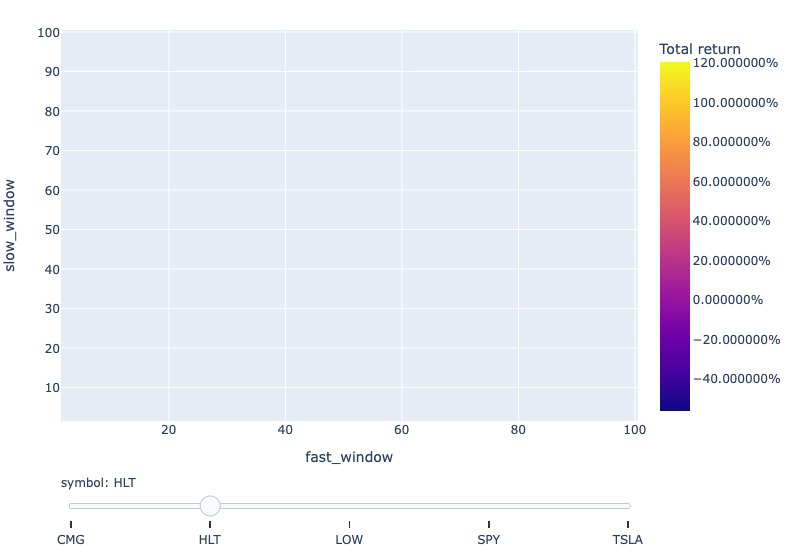

In [141]:
#Let's code a parameter hyperoptimization heatmap! We will look at 10,000 combinations of trading the fast and slow windows for each stock, and the combinations' associated return. 
#First we get the close data from our dataframe and set it equal to variable "price".
#Then we use the VBT module to calculate the data and plot. 
#Note: VBT uses "fig.show_svg()" which does not work with our code. If we simply replace it with "fig.show()" it works. 
price = pf_4_data_pivoted['close']
windows = np.arange(2, 101)
fast_ma, slow_ma = vbt.MA.run_combs(price, window=windows, r=2, short_names=['fast', 'slow'])
entries = fast_ma.ma_crossed_above(slow_ma)
exits = fast_ma.ma_crossed_below(slow_ma)

pf_kwargs = dict(size=np.inf, fees=0.001, freq='1D')
pf = vbt.Portfolio.from_signals(price, entries, exits, **pf_kwargs)

fig = pf.total_return().vbt.heatmap(
    x_level='fast_window', y_level='slow_window', slider_level='symbol', symmetric=True,
    trace_kwargs=dict(colorbar=dict(title='Total return', tickformat='%')))
fig.show()

In [124]:
#We can get the stats for each stock by referencing the index. 
pf[(10, 20, 'CMG')].stats()

Start                          2017-08-01 04:00:00+00:00
End                            2022-08-01 04:00:00+00:00
Period                                1259 days 00:00:00
Start Value                                        100.0
End Value                                      262.12305
Total Return [%]                               162.12305
Benchmark Return [%]                          348.502477
Max Gross Exposure [%]                             100.0
Total Fees Paid                                11.360944
Max Drawdown [%]                               37.434677
Max Drawdown Duration                  234 days 00:00:00
Total Trades                                          35
Total Closed Trades                                   34
Total Open Trades                                      1
Open Trade PnL                                 40.332791
Win Rate [%]                                   41.176471
Best Trade [%]                                 63.187102
Worst Trade [%]                

In [125]:
pf[(10, 20, 'HLT')].stats()

Start                          2017-08-01 04:00:00+00:00
End                            2022-08-01 04:00:00+00:00
Period                                1259 days 00:00:00
Start Value                                        100.0
End Value                                      49.780393
Total Return [%]                              -50.219607
Benchmark Return [%]                          105.018321
Max Gross Exposure [%]                             100.0
Total Fees Paid                                 5.463321
Max Drawdown [%]                               56.252898
Max Drawdown Duration                  652 days 00:00:00
Total Trades                                          36
Total Closed Trades                                   35
Total Open Trades                                      1
Open Trade PnL                                  2.769115
Win Rate [%]                                   31.428571
Best Trade [%]                                   19.4875
Worst Trade [%]                

Hilton actually lost money with this strategy. It's good to see the details of each stock to get an understanding of the performance. 

In [126]:
pf[(10, 20, 'LOW')].stats()

Start                         2017-08-01 04:00:00+00:00
End                           2022-08-01 04:00:00+00:00
Period                               1259 days 00:00:00
Start Value                                       100.0
End Value                                    255.935268
Total Return [%]                             155.935268
Benchmark Return [%]                         149.376847
Max Gross Exposure [%]                            100.0
Total Fees Paid                               12.102899
Max Drawdown [%]                              19.967884
Max Drawdown Duration                 194 days 00:00:00
Total Trades                                         33
Total Closed Trades                                  32
Total Open Trades                                     1
Open Trade PnL                                16.190777
Win Rate [%]                                       50.0
Best Trade [%]                                85.801555
Worst Trade [%]                              -14

In [127]:
pf[(10, 20, 'SPY')].stats()

Start                         2017-08-01 04:00:00+00:00
End                           2022-08-01 04:00:00+00:00
Period                               1259 days 00:00:00
Start Value                                       100.0
End Value                                     130.01645
Total Return [%]                               30.01645
Benchmark Return [%]                          66.088468
Max Gross Exposure [%]                            100.0
Total Fees Paid                                5.719606
Max Drawdown [%]                              21.106887
Max Drawdown Duration                 588 days 00:00:00
Total Trades                                         25
Total Closed Trades                                  24
Total Open Trades                                     1
Open Trade PnL                                 6.770658
Win Rate [%]                                       50.0
Best Trade [%]                                17.599143
Worst Trade [%]                              -11

In [128]:
pf[(10, 20, 'TSLA')].stats()

Start                          2017-08-01 04:00:00+00:00
End                            2022-08-01 04:00:00+00:00
Period                                1259 days 00:00:00
Start Value                                        100.0
End Value                                     258.335909
Total Return [%]                              158.335909
Benchmark Return [%]                          179.071878
Max Gross Exposure [%]                             100.0
Total Fees Paid                                 7.806339
Max Drawdown [%]                                81.38074
Max Drawdown Duration                  596 days 00:00:00
Total Trades                                          36
Total Closed Trades                                   35
Total Open Trades                                      1
Open Trade PnL                                 60.644678
Win Rate [%]                                   37.142857
Best Trade [%]                                187.656276
Worst Trade [%]                

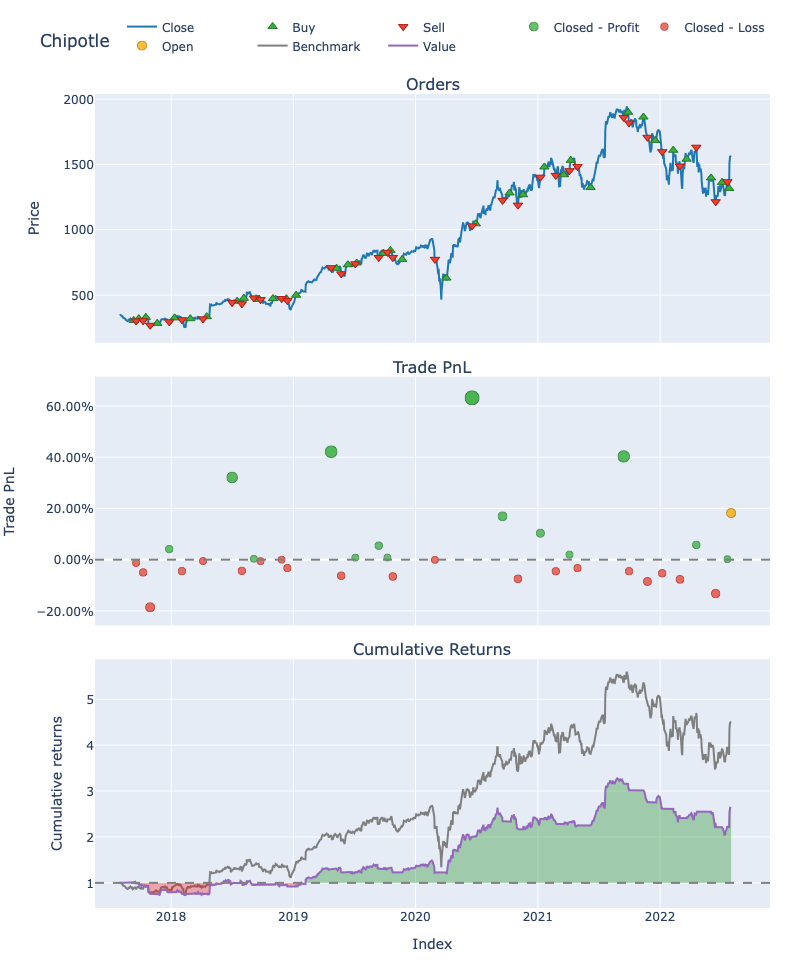

In [139]:
# Plot the stats to see the change over time. 
pf[(10, 20, 'CMG')].plot(title= 'Chipotle').show()

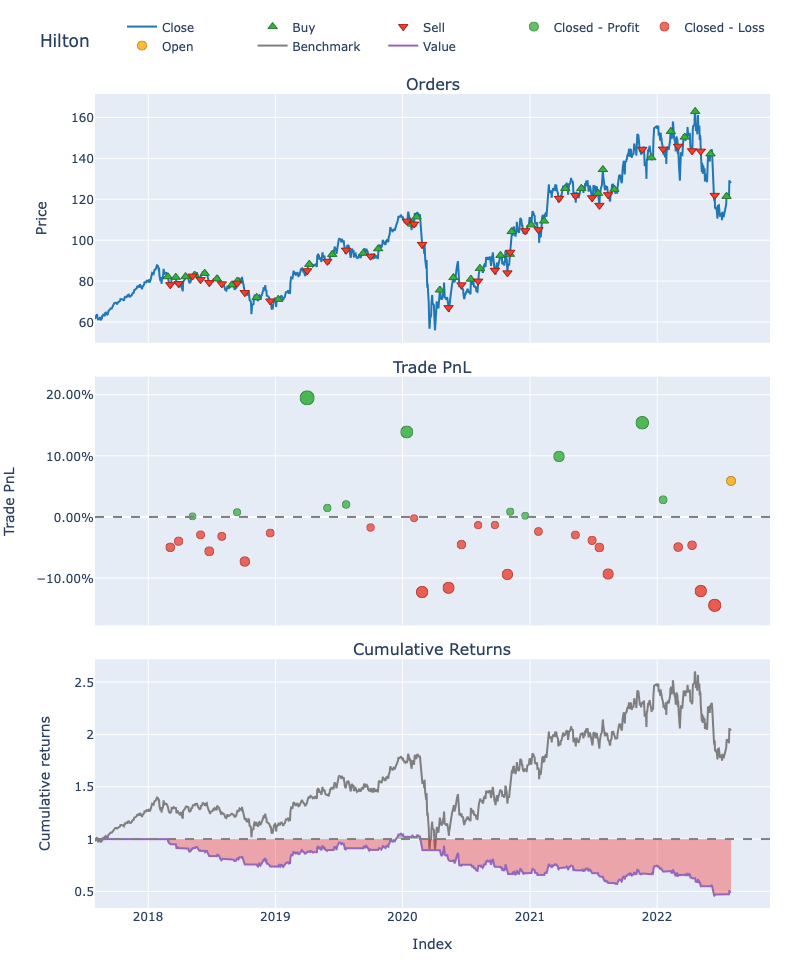

In [138]:
pf[(10, 20, 'HLT')].plot(title = "Hilton").show()

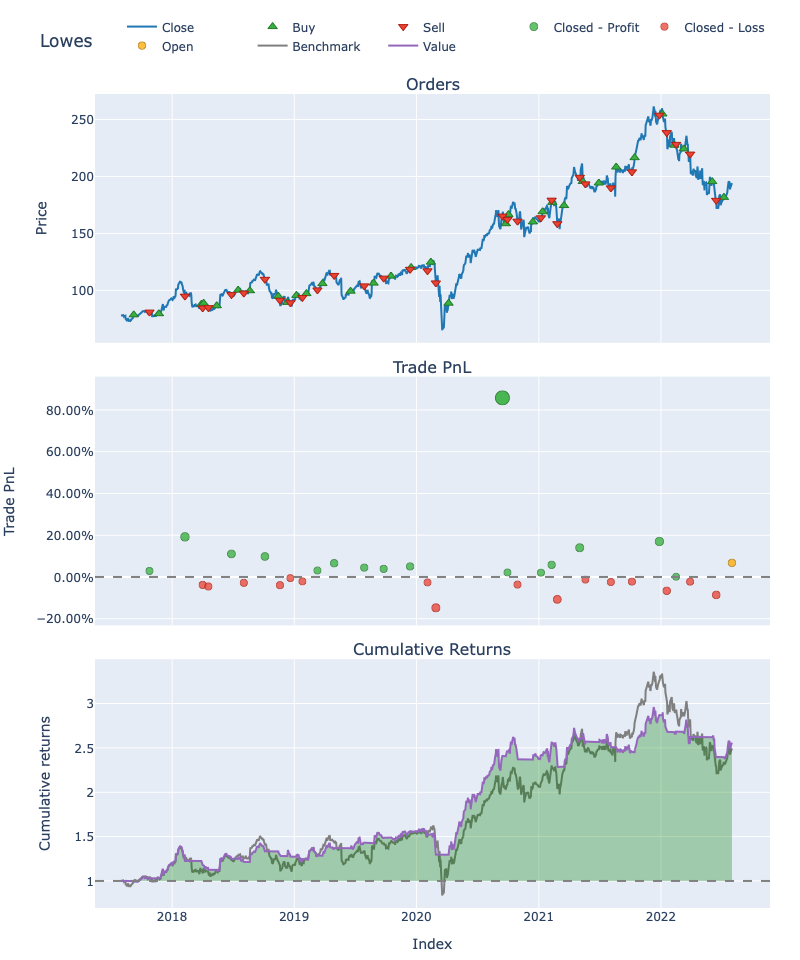

In [137]:
pf[(10, 20, 'LOW')].plot(title = 'Lowes').show()

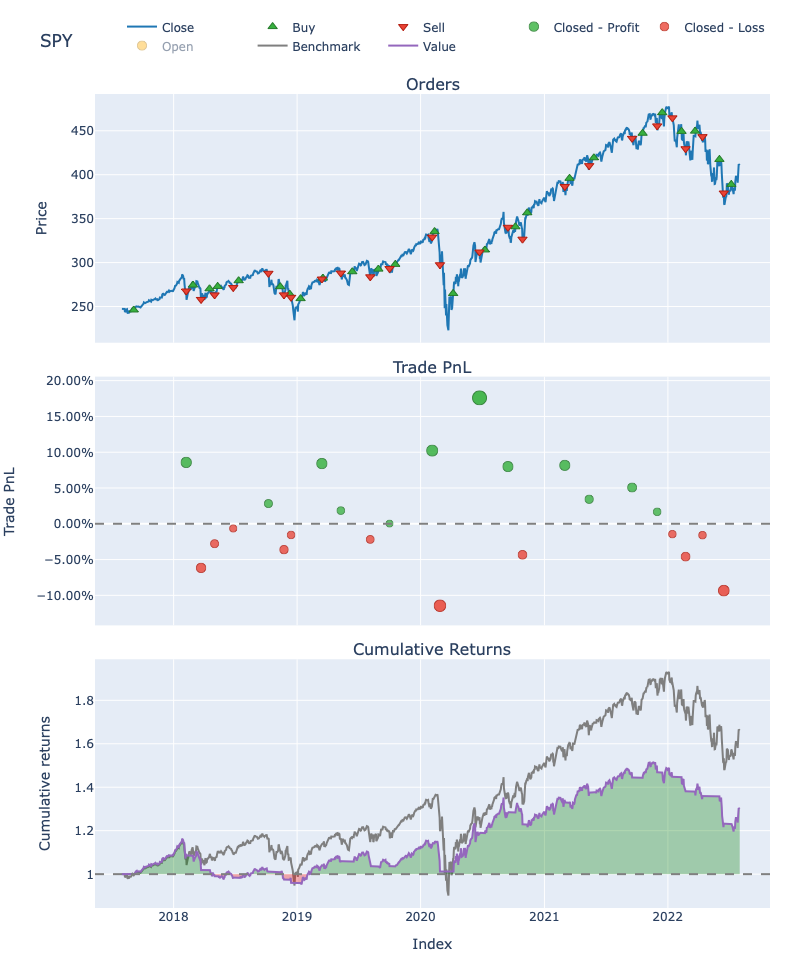

In [136]:
pf[(10, 20, 'SPY')].plot(title = 'SPY').show()

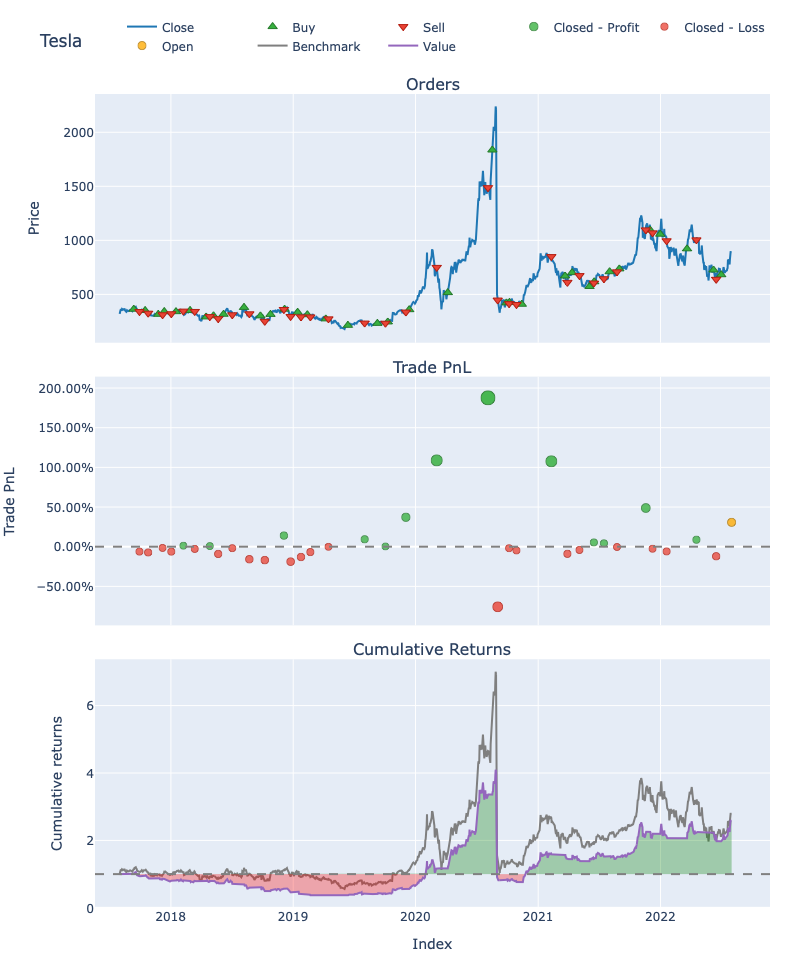

In [134]:
pf[(10, 20, 'TSLA')].plot(title = 'Tesla').show()

Portfolio Optimization: here we will use Vector BT to optimize our portfolio and compare it to our original model. First, we normalize the price and define "returns". Then we check the diversity of our portfolion by making sure there is not a high correlation between stocks. Then we generate 2000 groups of random weights to find the best group. While this is a good start we can also rebalance the portfolio monthly to get better returns. 

If we compare our portfolio to the larger set of the billionaires' top 5 we can get a sense of the performance of our portfolio. Our portfolio saw a total return percentage of 329.9% over 5 year;  while the original set of stocks saw a total return percentage of 136.4% 

In [144]:
price

symbol,CMG,HLT,LOW,SPY,TSLA
timestamp,,,,,
2017-08-01 04:00:00+00:00,347.24,62.77,77.83,247.32,319.57
2017-08-02 04:00:00+00:00,351.06,61.98,77.86,247.44,325.89
2017-08-03 04:00:00+00:00,345.36,62.13,77.91,246.96,347.09
2017-08-04 04:00:00+00:00,344.56,62.98,78.37,247.41,356.91
2017-08-07 04:00:00+00:00,339.45,63.77,78.32,247.87,355.17
...,...,...,...,...,...
2022-07-26 04:00:00+00:00,1316.43,120.22,188.60,390.89,776.58
2022-07-27 04:00:00+00:00,1510.00,129.25,189.92,401.04,824.46
2022-07-28 04:00:00+00:00,1538.88,128.00,190.80,406.07,842.70


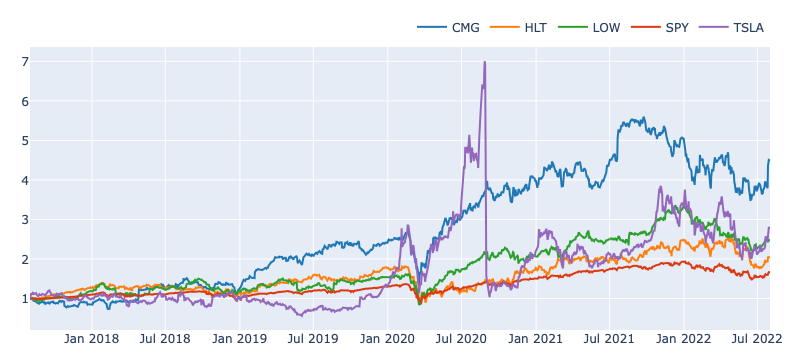

In [395]:
normalized_price = (price / price.iloc[0]).vbt.plot().show()

In [156]:
returns = price.pct_change()
returns

symbol,CMG,HLT,LOW,SPY,TSLA
timestamp,,,,,
2017-08-01 04:00:00+00:00,NaN,NaN,NaN,NaN,NaN
2017-08-02 04:00:00+00:00,0.011001,-0.012586,0.000385,0.000485,0.019777
2017-08-03 04:00:00+00:00,-0.016237,0.002420,0.000642,-0.001940,0.065053
2017-08-04 04:00:00+00:00,-0.002316,0.013681,0.005904,0.001822,0.028292
2017-08-07 04:00:00+00:00,-0.014831,0.012544,-0.000638,0.001859,-0.004875
...,...,...,...,...,...
2022-07-26 04:00:00+00:00,-0.009361,-0.016122,-0.031828,-0.011831,-0.035664
2022-07-27 04:00:00+00:00,0.147042,0.075112,0.006999,0.025966,0.061655
2022-07-28 04:00:00+00:00,0.019126,-0.009671,0.004634,0.012542,0.022124


In [159]:
returns.mean().sort_values()

symbol
SPY     0.000488
HLT     0.000797
LOW     0.000948
CMG     0.001496
TSLA    0.002186
dtype: float64

In [160]:
returns.std().sort_values()

symbol
SPY     0.012952
LOW     0.020817
HLT     0.021267
CMG     0.024790
TSLA    0.045654
dtype: float64

In [162]:
returns_correlation = returns.corr()
returns_correlation

symbol,CMG,HLT,LOW,SPY,TSLA
symbol,,,,,
CMG,1.000000,0.403132,0.392171,0.502406,0.307071
HLT,0.403132,1.000000,0.418145,0.613970,0.283374
LOW,0.392171,0.418145,1.000000,0.678585,0.292618
SPY,0.502406,0.613970,0.678585,1.000000,0.420249
TSLA,0.307071,0.283374,0.292618,0.420249,1.000000


<AxesSubplot:xlabel='symbol', ylabel='symbol'>

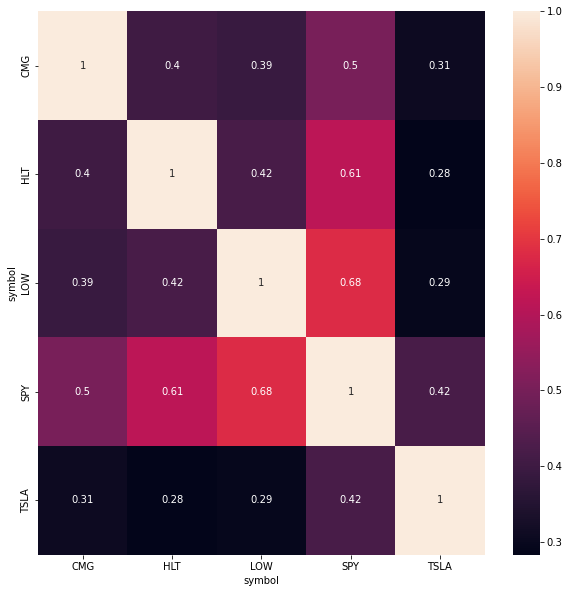

In [185]:
plt.figure(figsize= (10,10))
sns.heatmap(returns_correlation, annot=True)


Using a random search function to generate weights

In [233]:
#define parameters
num_tests = 2000

vbt.settings.array_wrapper['freq'] = 'days'
vbt.settings.returns['year_freq'] = '252 days'
vbt.settings.portfolio['seed'] = 42
vbt.settings.portfolio.stats['incl_unrealized'] = True

In [188]:
np.random.seed(42)

# Generate random weights, n times
weights = []
for i in range(num_tests):
    w = np.random.random_sample(len(pf_4_tickers))
    w = w / np.sum(w)
    weights.append(w)

print(len(weights))

2000


In [189]:
# Build column hierarchy such that one weight corresponds to one price series
_price = price.vbt.tile(num_tests, keys=pd.Index(np.arange(num_tests), name='symbol_group'))
_price = _price.vbt.stack_index(pd.Index(np.concatenate(weights), name='weights'))

print(_price.columns)

MultiIndex([( 0.13319702814025883,    0,  'CMG'),
            ( 0.33810081711389406,    0,  'HLT'),
            ( 0.26031768763785473,    0,  'LOW'),
            (  0.2128998389048247,    0,  'SPY'),
            ( 0.05548462820316767,    0, 'TSLA'),
            ( 0.06528491964469331,    1,  'CMG'),
            ( 0.02430844330237927,    1,  'HLT'),
            (  0.3625014516740258,    1,  'LOW'),
            (  0.2515713061862386,    1,  'SPY'),
            ( 0.29633387919266296,    1, 'TSLA'),
            ...
            (  0.2056564359049325, 1998,  'CMG'),
            ( 0.14846396871443943, 1998,  'HLT'),
            ( 0.21512097636364197, 1998,  'LOW'),
            (  0.3738566007394396, 1998,  'SPY'),
            (0.056902018277546554, 1998, 'TSLA'),
            ( 0.25860265182212094, 1999,  'CMG'),
            (  0.2706191852849979, 1999,  'HLT'),
            (  0.2854538191129893, 1999,  'LOW'),
            ( 0.11985160754099378, 1999,  'SPY'),
            (  0.0654727362388982,

In [190]:
# Define order size
size = np.full_like(_price, np.nan)
size[0, :] = np.concatenate(weights)  # allocate at first timestamp, do nothing afterwards

print(size.shape)

(1259, 10000)


In [191]:
# Run simulation
pf = vbt.Portfolio.from_orders(
    close=_price,
    size=size,
    size_type='targetpercent',
    group_by='symbol_group',
    cash_sharing=True
) # all weights sum to 1, no shorting, and 100% investment in risky assets

print(len(pf.orders))

10000


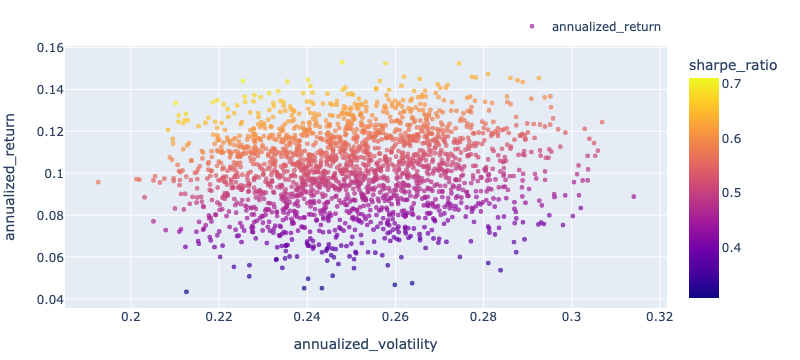

In [246]:
# Plot annualized return against volatility, color by sharpe ratio
annualized_return = pf.annualized_return()
annualized_return.index = pf.annualized_volatility()
annualized_return.vbt.scatterplot(
    trace_kwargs=dict(
        mode='markers', 
        marker=dict(
            color=pf.sharpe_ratio(),
            colorbar=dict(
                title='sharpe_ratio'
            ),
            size=5,
            opacity=0.7
        )
    ),
    xaxis_title='annualized_volatility',
    yaxis_title='annualized_return'
).show()

In [194]:
# Get index of the best group according to the target metric
best_symbol_group = pf.sharpe_ratio().idxmax()

print(best_symbol_group)

995


In [195]:
# Print best weights
print(weights[best_symbol_group])

[0.54721425 0.15121899 0.2523137  0.00115563 0.04809743]


In [196]:
# Compute default stats
print(pf.iloc[best_symbol_group].stats())

Start                         2017-08-01 04:00:00+00:00
End                           2022-08-01 04:00:00+00:00
Period                               1259 days 00:00:00
Start Value                                       100.0
End Value                                    352.965381
Total Return [%]                             252.965381
Benchmark Return [%]                         169.611598
Max Gross Exposure [%]                            100.0
Total Fees Paid                                     0.0
Max Drawdown [%]                              50.241248
Max Drawdown Duration                 178 days 00:00:00
Total Trades                                          5
Total Closed Trades                                   0
Total Open Trades                                     5
Open Trade PnL                               252.965381
Win Rate [%]                                        NaN
Best Trade [%]                                      NaN
Worst Trade [%]                                 

In [211]:
def plot_allocation(pf):
    # Plot weights development of the portfolio
    asset_value = pf.asset_value(group_by=False)
    value = pf.value()
    idxs = np.flatnonzero((pf.asset_flow() != 0).any(axis=1))
    dates = pf.wrapper.index[idxs]
    fig = (asset_value.vbt / value).vbt.plot(
        trace_names=pf_4_tickers,
        trace_kwargs=dict(
            stackgroup='one'
        )
    )
    for date in dates:
        fig.add_shape(
            dict(
                xref='x',
                yref='paper',
                x0=date,
                x1=date,
                y0=0,
                y1=1,
                line_color=fig.layout.template.layout.plot_bgcolor
            )
        )
    fig.show()

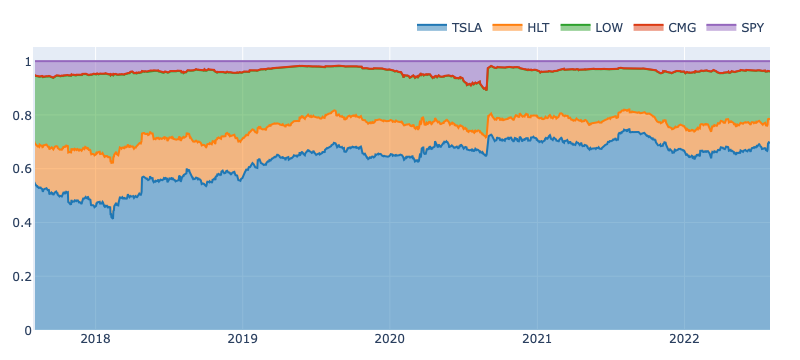

In [212]:
plot_allocation(pf.iloc[best_symbol_group])  # best group

In [213]:
# Select the first index of each month
rb_mask = ~_price.index.to_period('m').duplicated()

print(rb_mask.sum())

61


/Users/mikecutno/opt/anaconda3/envs/dev/lib/python3.9/site-packages/pandas/core/arrays/datetimes.py:1162: UserWarning:

Converting to PeriodArray/Index representation will drop timezone information.



In [214]:
rb_size = np.full_like(_price, np.nan)
rb_size[rb_mask, :] = np.concatenate(weights)  # allocate at mask

print(rb_size.shape)

(1259, 10000)


In [215]:
# Run simulation, with rebalancing monthly
rb_pf = vbt.Portfolio.from_orders(
    close=_price,
    size=rb_size,
    size_type='targetpercent',
    group_by='symbol_group',
    cash_sharing=True,
    call_seq='auto'  # important: sell before buy
)

print(len(rb_pf.orders))

609995


In [216]:
rb_best_symbol_group = rb_pf.sharpe_ratio().idxmax()

print(rb_best_symbol_group)

296


In [217]:
print(weights[rb_best_symbol_group])

[0.45112508 0.06630845 0.30034533 0.00317653 0.17904461]


In [218]:
print(rb_pf.iloc[rb_best_symbol_group].stats())

Start                           2017-08-01 04:00:00+00:00
End                             2022-08-01 04:00:00+00:00
Period                                 1259 days 00:00:00
Start Value                                         100.0
End Value                                       429.99929
Total Return [%]                                329.99929
Benchmark Return [%]                           169.611598
Max Gross Exposure [%]                              100.0
Total Fees Paid                                       0.0
Max Drawdown [%]                                51.208036
Max Drawdown Duration                   184 days 00:00:00
Total Trades                                          143
Total Closed Trades                                   138
Total Open Trades                                       5
Open Trade PnL                                 139.587613
Win Rate [%]                                    95.652174
Best Trade [%]                                 396.882035
Worst Trade [%

In [397]:
def plot_allocation(rb_pf):
    # Plot weights development of the portfolio
    rb_asset_value = rb_pf.asset_value(group_by=False)
    rb_value = rb_pf.value()
    rb_idxs = np.flatnonzero((rb_pf.asset_flow() != 0).any(axis=1))
    rb_dates = rb_pf.wrapper.index[rb_idxs]
    fig = (rb_asset_value.vbt / rb_value).vbt.plot(
        trace_names=pf_4_tickers,
        trace_kwargs=dict(
            stackgroup='one'
        )
    )
    for rb_date in rb_dates:
        fig.add_shape(
            dict(
                xref='x',
                yref='paper',
                x0=rb_date,
                x1=rb_date,
                y0=0,
                y1=1,
                line_color=fig.layout.template.layout.plot_bgcolor
            )
        )
    fig.show()

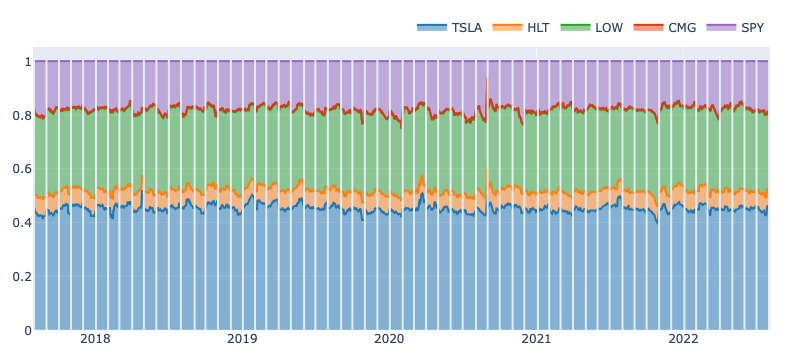

In [398]:
plot_allocation(rb_pf.iloc[rb_best_symbol_group])  # best group

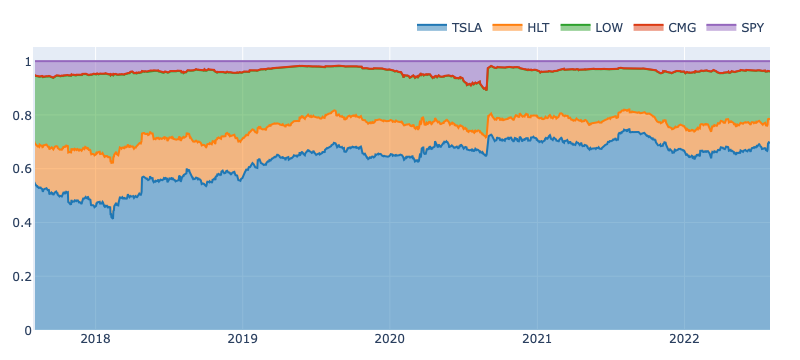

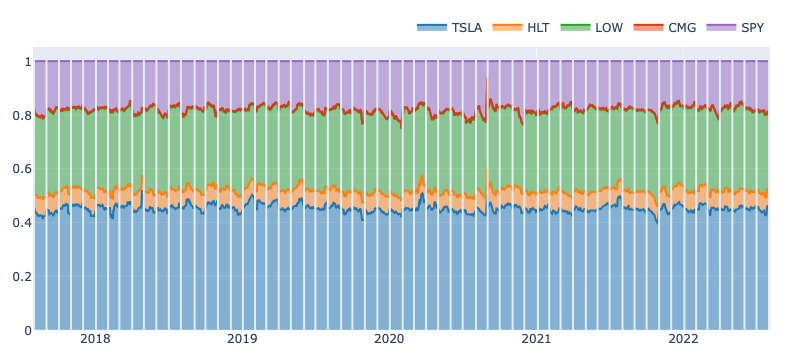

In [222]:
plot_allocation(pf.iloc[best_symbol_group])
plot_allocation(rb_pf.iloc[rb_best_symbol_group])

Compare the selected portfolio versus the original set of stocks from the billionaires' top 5 to see if we chose the best performing stocks. 

In [223]:
price_all = ticker_data_pivoted['close']
price_all

symbol,AAPL,AMZN,AXP,BAC,CMG,CVX,HHC,HLT,JNJ,KO,LOW,PEP,PG,QSR,SPY,TDOC,TSLA
timestamp,,,,,,,,,,,,,,,,,
2017-08-01 04:00:00+00:00,150.05,996.19,85.24,24.45,347.24,110.78,125.91,62.77,132.51,45.70,77.83,115.92,91.10,59.25,247.32,32.55,319.57
2017-08-02 04:00:00+00:00,157.14,995.89,85.30,24.59,351.06,110.46,126.01,61.98,132.16,45.59,77.86,115.61,91.04,59.69,247.44,30.75,325.89
2017-08-03 04:00:00+00:00,155.57,986.92,85.54,24.37,345.36,109.43,126.09,62.13,133.35,45.67,77.91,116.30,90.86,60.69,246.96,30.25,347.09
2017-08-04 04:00:00+00:00,156.39,987.58,85.97,24.97,344.56,110.11,125.41,62.98,133.18,45.50,78.37,116.37,90.67,62.11,247.41,30.90,356.91
2017-08-07 04:00:00+00:00,158.81,992.27,85.85,24.96,339.45,109.78,125.77,63.77,132.86,45.64,78.32,116.96,91.44,62.16,247.87,31.70,355.17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-07-26 04:00:00+00:00,151.60,114.81,149.83,33.05,1316.43,147.32,69.81,120.22,173.68,63.21,188.60,171.83,144.27,50.85,390.89,40.19,776.58
2022-07-27 04:00:00+00:00,156.79,120.97,151.63,33.59,1510.00,149.26,71.32,129.25,173.20,63.01,189.92,171.59,145.64,52.05,401.04,43.24,824.46
2022-07-28 04:00:00+00:00,157.35,122.28,152.14,33.32,1538.88,150.39,71.46,128.00,174.20,64.06,190.80,174.84,148.06,53.12,406.07,35.60,842.70


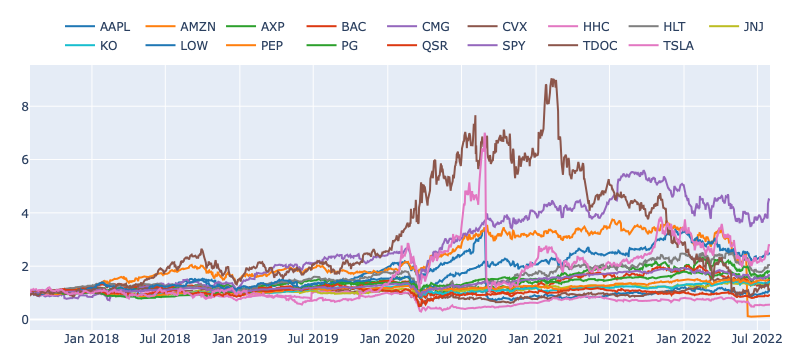

In [224]:
normalized_price_all = (price_all / price_all.iloc[0]).vbt.plot().show()

In [225]:
returns_all = price_all.pct_change()
returns_all

symbol,AAPL,AMZN,AXP,BAC,CMG,CVX,HHC,HLT,JNJ,KO,LOW,PEP,PG,QSR,SPY,TDOC,TSLA
timestamp,,,,,,,,,,,,,,,,,
2017-08-01 04:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-08-02 04:00:00+00:00,0.047251,-0.000301,0.000704,0.005726,0.011001,-0.002889,0.000794,-0.012586,-0.002641,-0.002407,0.000385,-0.002674,-0.000659,0.007426,0.000485,-0.055300,0.019777
2017-08-03 04:00:00+00:00,-0.009991,-0.009007,0.002814,-0.008947,-0.016237,-0.009325,0.000635,0.002420,0.009004,0.001755,0.000642,0.005968,-0.001977,0.016753,-0.001940,-0.016260,0.065053
2017-08-04 04:00:00+00:00,0.005271,0.000669,0.005027,0.024620,-0.002316,0.006214,-0.005393,0.013681,-0.001275,-0.003722,0.005904,0.000602,-0.002091,0.023398,0.001822,0.021488,0.028292
2017-08-07 04:00:00+00:00,0.015474,0.004749,-0.001396,-0.000400,-0.014831,-0.002997,0.002871,0.012544,-0.002403,0.003077,-0.000638,0.005070,0.008492,0.000805,0.001859,0.025890,-0.004875
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-07-26 04:00:00+00:00,-0.008826,-0.052254,-0.025749,-0.020160,-0.009361,-0.007812,-0.000143,-0.016122,0.007074,0.016401,-0.031828,0.011657,0.001945,-0.010893,-0.011831,-0.044914,-0.035664
2022-07-27 04:00:00+00:00,0.034235,0.053654,0.012014,0.016339,0.147042,0.013169,0.021630,0.075112,-0.002764,-0.003164,0.006999,-0.001397,0.009496,0.023599,0.025966,0.075890,0.061655
2022-07-28 04:00:00+00:00,0.003572,0.010829,0.003363,-0.008038,0.019126,0.007571,0.001963,-0.009671,0.005774,0.016664,0.004634,0.018940,0.016616,0.020557,0.012542,-0.176688,0.022124


In [227]:
returns_all.mean().sort_values()

symbol
HHC    -0.000106
QSR     0.000135
AMZN    0.000256
JNJ     0.000301
KO      0.000364
PEP     0.000431
PG      0.000450
SPY     0.000488
BAC     0.000495
CVX     0.000538
AXP     0.000728
AAPL    0.000751
HLT     0.000797
TDOC    0.000906
LOW     0.000948
CMG     0.001496
TSLA    0.002186
dtype: float64

In [228]:
returns_all.std().sort_values()

symbol
SPY     0.012952
JNJ     0.013032
KO      0.013368
PG      0.013590
PEP     0.013753
QSR     0.020049
LOW     0.020817
HLT     0.021267
BAC     0.021947
CVX     0.021948
AXP     0.023051
CMG     0.024790
HHC     0.027190
AAPL    0.029142
AMZN    0.034353
TDOC    0.039578
TSLA    0.045654
dtype: float64

In [229]:
returns_all_correlation = returns_all.corr()
returns_all_correlation

symbol,AAPL,AMZN,AXP,BAC,CMG,CVX,HHC,HLT,JNJ,KO,LOW,PEP,PG,QSR,SPY,TDOC,TSLA
symbol,,,,,,,,,,,,,,,,,
AAPL,1.000000,0.267645,0.330150,0.342547,0.276752,0.275680,0.281532,0.298705,0.285298,0.281491,0.350578,0.343109,0.287939,0.279552,0.555075,0.220318,0.623325
AMZN,0.267645,1.000000,0.198346,0.201815,0.265392,0.140813,0.151002,0.202281,0.165868,0.141441,0.225002,0.189057,0.155760,0.164276,0.401409,0.262939,0.215777
AXP,0.330150,0.198346,1.000000,0.790472,0.359458,0.650760,0.593679,0.671043,0.410964,0.538919,0.486775,0.435711,0.355176,0.622568,0.739197,0.039888,0.263788
BAC,0.342547,0.201815,0.790472,1.000000,0.272723,0.644807,0.524748,0.544567,0.409156,0.489671,0.476368,0.430683,0.362984,0.482334,0.740933,0.094551,0.255889
CMG,0.276752,0.265392,0.359458,0.272723,1.000000,0.284424,0.295718,0.403132,0.180351,0.205993,0.392171,0.222753,0.166818,0.413727,0.502406,0.261094,0.307071
CVX,0.275680,0.140813,0.650760,0.644807,0.284424,1.000000,0.465125,0.486151,0.392556,0.456821,0.449296,0.377038,0.267960,0.497791,0.635880,-0.019023,0.230095
HHC,0.281532,0.151002,0.593679,0.524748,0.295718,0.465125,1.000000,0.530377,0.291785,0.447191,0.440365,0.338071,0.272482,0.520604,0.578730,0.094512,0.249092
HLT,0.298705,0.202281,0.671043,0.544567,0.403132,0.486151,0.530377,1.000000,0.235335,0.363778,0.418145,0.228000,0.165139,0.580550,0.613970,0.153866,0.283374
JNJ,0.285298,0.165868,0.410964,0.409156,0.180351,0.392556,0.291785,0.235335,1.000000,0.550717,0.367436,0.615474,0.586367,0.271972,0.588181,0.058866,0.120671


<AxesSubplot:xlabel='symbol', ylabel='symbol'>

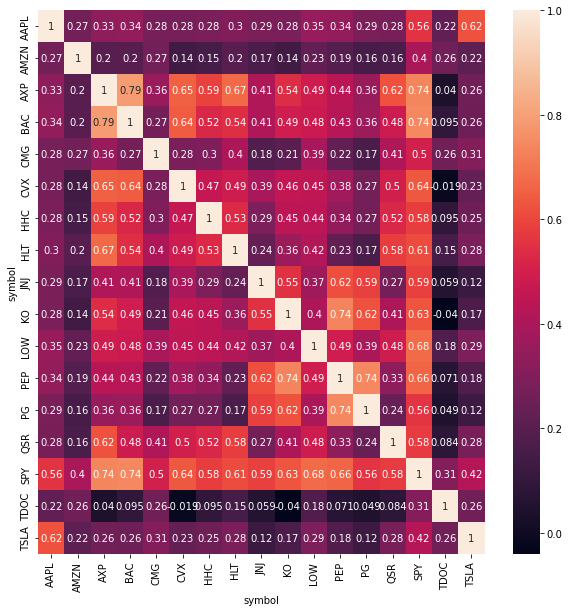

In [230]:
plt.figure(figsize= (10,10))
sns.heatmap(returns_all_correlation, annot=True)



Using a random search function to generate weights

In [237]:
np.random.seed(42)

# Generate random weights, n times
weights = []
for i in range(num_tests):
    w = np.random.random_sample(len(tickers))
    w = w / np.sum(w)
    weights.append(w)

print(len(weights))

2000


In [238]:
# Build column hierarchy such that one weight corresponds to one price series
_price = price_all.vbt.tile(num_tests, keys=pd.Index(np.arange(num_tests), name='symbol_group'))
_price = _price.vbt.stack_index(pd.Index(np.concatenate(weights), name='weights'))

print(_price.columns)

MultiIndex([(  0.04737347109665895,    0, 'AAPL'),
            (  0.12025050041233383,    0, 'AMZN'),
            (  0.09258579281720183,    0,  'AXP'),
            (  0.07572094141785604,    0,  'BAC'),
            ( 0.019733919496490383,    0,  'CMG'),
            (  0.01973086868004104,    0,  'CVX'),
            (0.0073466691117303855,    0,  'HHC'),
            (  0.10955774439535265,    0,  'HLT'),
            (  0.07603165375773802,    0,  'JNJ'),
            (  0.08956011415222515,    0,   'KO'),
            ...
            (  0.03229538550164616, 1999,  'HLT'),
            (  0.03645340666506197, 1999,  'JNJ'),
            (  0.06843969327078811, 1999,   'KO'),
            (  0.08973425821557258, 1999,  'LOW'),
            (  0.06915141863737923, 1999,  'PEP'),
            (   0.0749117580696473, 1999,   'PG'),
            (   0.0724900771312044, 1999,  'QSR'),
            (  0.03099148537767546, 1999,  'SPY'),
            (  0.07308399380697242, 1999, 'TDOC'),
            (  

In [239]:
# Define order size
size_all = np.full_like(_price, np.nan)
size_all[0, :] = np.concatenate(weights)  # allocate at first timestamp, do nothing afterwards

print(size.shape)

(1259, 10000)


In [244]:
pf_all = vbt.Portfolio.from_orders(
    close=_price,
    size=size_all,
    size_type='targetpercent',
    group_by='symbol_group',
    cash_sharing=True
) # all weights sum to 1, no shorting, and 100% investment in risky assets

print(len(pf_all.orders))

34000


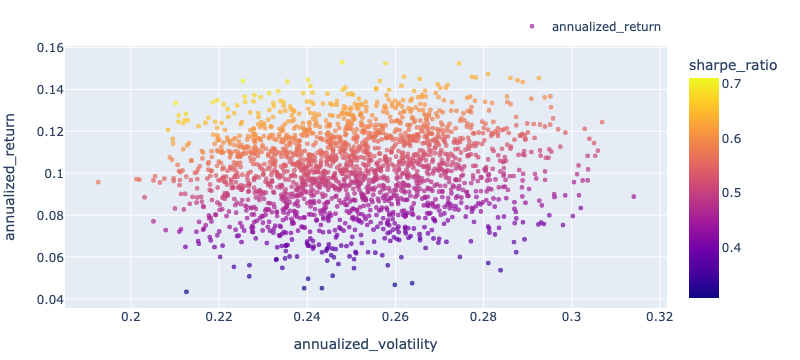

In [245]:
# Plot annualized return against volatility, color by sharpe ratio
annualized_return_all = pf_all.annualized_return()
annualized_return_all.index = pf_all.annualized_volatility()
annualized_return_all.vbt.scatterplot(
    trace_kwargs=dict(
        mode='markers', 
        marker=dict(
            color=pf_all.sharpe_ratio(),
            colorbar=dict(
                title='sharpe_ratio'
            ),
            size=5,
            opacity=0.7
        )
    ),
    xaxis_title='annualized_volatility',
    yaxis_title='annualized_return'
).show()

In [247]:
# Get index of the best group according to the target metric
best_symbol_group_all = pf_all.sharpe_ratio().idxmax()

print(best_symbol_group_all)

1604


In [248]:
# Print best weights
print(weights[best_symbol_group_all])

[0.04549951 0.00376647 0.03121841 0.09938872 0.14405823 0.0019482
 0.04459013 0.00903311 0.0460751  0.05911992 0.13412016 0.01173338
 0.1131867  0.05760812 0.11815743 0.07477513 0.00572128]


In [249]:
# Compute default stats
print(pf.iloc[best_symbol_group_all].stats())

Start                         2017-08-01 04:00:00+00:00
End                           2022-08-01 04:00:00+00:00
Period                               1259 days 00:00:00
Start Value                                       100.0
End Value                                    195.852006
Total Return [%]                              95.852006
Benchmark Return [%]                          63.207414
Max Gross Exposure [%]                            100.0
Total Fees Paid                                     0.0
Max Drawdown [%]                              33.012157
Max Drawdown Duration                 184 days 00:00:00
Total Trades                                         17
Total Closed Trades                                   0
Total Open Trades                                    17
Open Trade PnL                                95.852006
Win Rate [%]                                        NaN
Best Trade [%]                                      NaN
Worst Trade [%]                                 

In [250]:
def plot_allocation(pf_all):
    # Plot weights development of the portfolio
    asset_value = pf_all.asset_value(group_by=False)
    value = pf_all.value()
    idxs = np.flatnonzero((pf_all.asset_flow() != 0).any(axis=1))
    dates = pf_all.wrapper.index[idxs]
    fig = (asset_value.vbt / value).vbt.plot(
        trace_names=tickers,
        trace_kwargs=dict(
            stackgroup='one'
        )
    )
    for date in dates:
        fig.add_shape(
            dict(
                xref='x',
                yref='paper',
                x0=date,
                x1=date,
                y0=0,
                y1=1,
                line_color=fig.layout.template.layout.plot_bgcolor
            )
        )
    fig.show()

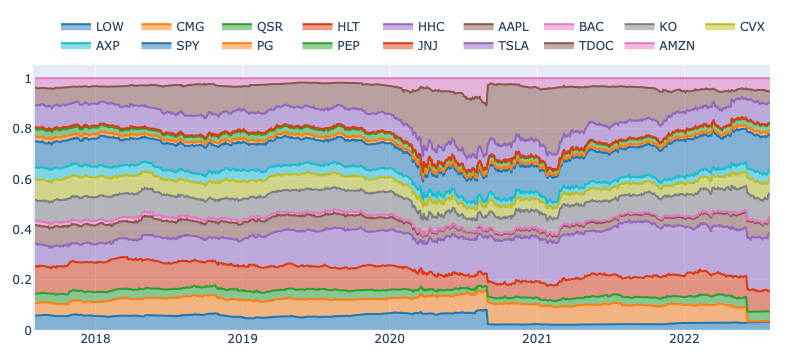

In [251]:
plot_allocation(pf_all.iloc[best_symbol_group])  # best group

In [253]:
# Select the first index of each month
rb_mask = ~_price.index.to_period('m').duplicated()

print(rb_mask.sum())

61


/Users/mikecutno/opt/anaconda3/envs/dev/lib/python3.9/site-packages/pandas/core/arrays/datetimes.py:1162: UserWarning:

Converting to PeriodArray/Index representation will drop timezone information.



In [254]:
rb_size_all = np.full_like(_price, np.nan)
rb_size_all[rb_mask, :] = np.concatenate(weights)  # allocate at mask

print(rb_size_all.shape)

(1259, 34000)


In [255]:
# Run simulation, with rebalancing monthly
rb_pf_all = vbt.Portfolio.from_orders(
    close=_price,
    size=rb_size_all,
    size_type='targetpercent',
    group_by='symbol_group',
    cash_sharing=True,
    call_seq='auto'  # important: sell before buy
)

print(len(rb_pf.orders))

609995


In [256]:
rb_best_symbol_group_all = rb_pf_all.sharpe_ratio().idxmax()

print(rb_best_symbol_group_all)

22


In [409]:
# Print best weights
print(weights[rb_best_symbol_group_all])

[0.00771949 0.03458881 0.09161587 0.00252354 0.08831864 0.03056353
 0.01281346 0.07555219 0.06820077 0.09515056 0.079709   0.08712718
 0.03058302 0.01924104 0.08139452 0.08749085 0.10740755]


In [259]:
print(rb_pf_all.iloc[rb_best_symbol_group_all].stats())

Start                           2017-08-01 04:00:00+00:00
End                             2022-08-01 04:00:00+00:00
Period                                 1259 days 00:00:00
Start Value                                         100.0
End Value                                      236.407606
Total Return [%]                               136.407606
Benchmark Return [%]                            63.207414
Max Gross Exposure [%]                              100.0
Total Fees Paid                                       0.0
Max Drawdown [%]                                34.182904
Max Drawdown Duration                   183 days 00:00:00
Total Trades                                          469
Total Closed Trades                                   452
Total Open Trades                                      17
Open Trade PnL                                  27.486002
Win Rate [%]                                    89.159292
Best Trade [%]                                 376.219332
Worst Trade [%

In [260]:
def plot_allocation(rb_pf_all):
    # Plot weights development of the portfolio
    rb_asset_value = rb_pf_all.asset_value(group_by=False)
    rb_value = rb_pf_all.value()
    rb_idxs = np.flatnonzero((rb_pf_all.asset_flow() != 0).any(axis=1))
    rb_dates = rb_pf_all.wrapper.index[rb_idxs]
    fig = (rb_asset_value.vbt / rb_value).vbt.plot(
        trace_names=tickers,
        trace_kwargs=dict(
            stackgroup='one'
        )
    )
    for rb_date in rb_dates:
        fig.add_shape(
            dict(
                xref='x',
                yref='paper',
                x0=rb_date,
                x1=rb_date,
                y0=0,
                y1=1,
                line_color=fig.layout.template.layout.plot_bgcolor
            )
        )
    fig.show()

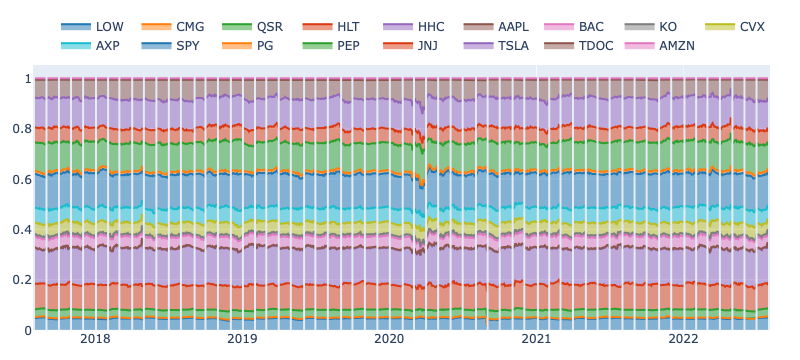

In [262]:
plot_allocation(rb_pf_all.iloc[best_symbol_group_all])  # best group

Retesting the Monte Carlo Simulation with new weights to check and optimize our model. 

Weights:

CMG 0.00317653 
HLT 0.06630845 
LOW 0.30034533 
SPY 0.17904461
TSLA 0.45112508 


In [426]:
price_2 = price.reindex(
    columns = ['CMG','HLT', 'LOW', 'SPY', 'TSLA'],
    
)
price_2

symbol,CMG,HLT,LOW,SPY,TSLA
timestamp,,,,,
2017-08-01 04:00:00+00:00,347.24,62.77,77.83,247.32,319.57
2017-08-02 04:00:00+00:00,351.06,61.98,77.86,247.44,325.89
2017-08-03 04:00:00+00:00,345.36,62.13,77.91,246.96,347.09
2017-08-04 04:00:00+00:00,344.56,62.98,78.37,247.41,356.91
2017-08-07 04:00:00+00:00,339.45,63.77,78.32,247.87,355.17
...,...,...,...,...,...
2022-07-26 04:00:00+00:00,1316.43,120.22,188.60,390.89,776.58
2022-07-27 04:00:00+00:00,1510.00,129.25,189.92,401.04,824.46
2022-07-28 04:00:00+00:00,1538.88,128.00,190.80,406.07,842.70


In [440]:
#Get data from the Alpaca API. 
#The data has to be formatted to work with the Monte Carlo simulation. So we have to create a new dataframe. 
tickers = pf_4_tickers
df_pf_4 = api.get_bars(
    tickers,
    timeframe,
    start = start_date,
    end = end_date
).df
# Reorganize the DataFrame
df_pf_4.index = df_pf_4.index.date
df_pf_4 = df_pf_4.drop(['trade_count', 'vwap','open', 'high', 'low', 'volume'], axis=1)
# Separate ticker data

CMG = df_pf_4[df_pf_4['symbol']=='CMG'].drop('symbol', axis=1)
HLT = df_pf_4[df_pf_4['symbol']=='HLT'].drop('symbol', axis=1)
LOW = df_pf_4[df_pf_4['symbol']=='LOW'].drop('symbol', axis=1)
SPY = df_pf_4[df_pf_4['symbol']=='SPY'].drop('symbol', axis=1)
TSLA =df_pf_4[df_pf_4['symbol']=='TSLA'].drop('symbol', axis=1)
# Concatenate the ticker DataFrames
df_pf_4 = pd.concat([CMG, HLT, LOW, TSLA, SPY], axis=1, keys=['CMG', 'HLT', 'LOW', 'SPY', 'TSLA'])


# Display both the first and last five rows of the DataFrame
df_pf_4

,CMG,HLT,LOW,SPY,TSLA
,close,close,close,close,close
2017-08-01,347.24,62.77,77.83,319.57,247.32
2017-08-02,351.06,61.98,77.86,325.89,247.44
2017-08-03,345.36,62.13,77.91,347.09,246.96
2017-08-04,344.56,62.98,78.37,356.91,247.41
2017-08-07,339.45,63.77,78.32,355.17,247.87
...,...,...,...,...,...
2022-07-26,1316.43,120.22,188.60,776.58,390.89
2022-07-27,1510.00,129.25,189.92,824.46,401.04
2022-07-28,1538.88,128.00,190.80,842.70,406.07


In [441]:
# Configure the Monte Carlo simulation to forecast 1 year cumulative returns
# The weights are generated by the portfolio optimization.
# Run 500 samples.
# Review the simulation input data
MC_1year = MCSimulation(
    portfolio_data = df_pf_4,
    weights = [.00317653, .06630845, .30034533, .17904461, .45112508],
    num_simulation = 500,
    num_trading_days= 252
)
MC_1year.portfolio_data.tail()

CMG                  HLT                  LOW               \
              close daily_return   close daily_return   close daily_return   
2022-07-26  1316.43    -0.009361  120.22    -0.016122  188.60    -0.031828   
2022-07-27  1510.00     0.147042  129.25     0.075112  189.92     0.006999   
2022-07-28  1538.88     0.019126  128.00    -0.009671  190.80     0.004634   
2022-07-29  1564.22     0.016467  128.07     0.000547  191.53     0.003826   
2022-08-01  1557.38    -0.004373  128.69     0.004841  194.09     0.013366   

               SPY                 TSLA               
             close daily_return   close daily_return  
2022-07-26  776.58    -0.035664  390.89    -0.011831  
2022-07-27  824.46     0.061655  401.04     0.025966  
2022-07-28  842.70     0.022124  406.07     0.012542  
2022-07-29  891.45     0.057850  411.99     0.014579  
2022-08-01  891.83     0.000426  410.77    -0.002961

In [442]:
MC_1year.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 130.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 140.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 150.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 160.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 170.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 200.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 210.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 220.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 230.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 240.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 250.
Running Monte Carlo simulation number 260.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 270.
Running Monte Carlo simulation number 280.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 290.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 300.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 310.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 320.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 330.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 340.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 350.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 360.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 370.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 380.
Running Monte Carlo simulation number 390.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 400.
Running Monte Carlo simulation number 410.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 420.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 430.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 440.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 450.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 460.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 470.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 480.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 490.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.010083,0.993340,0.987891,0.984005,1.014066,0.987749,0.996612,0.979584,0.975654,1.011842,...,1.002540,1.004729,1.008651,1.006695,1.011137,1.015313,0.980422,1.001706,1.013295,1.025426
2,1.007797,0.969698,0.979524,0.978810,0.995748,0.980923,0.994295,0.987189,0.972233,1.000934,...,1.019370,1.002298,1.002661,0.999515,1.030643,0.996104,0.960892,1.012148,1.029223,1.045183
3,1.003604,0.990720,0.990182,0.972475,1.023381,0.989042,0.991830,0.971482,0.976902,1.010347,...,1.023707,0.998928,0.995083,1.012878,1.026113,0.979416,0.943025,1.003268,1.024759,1.049410
4,1.005479,0.977477,1.008718,0.979573,1.027716,0.993599,0.997184,0.973685,0.976962,1.003665,...,1.028292,0.996124,0.978713,0.991567,1.052822,0.977664,0.924039,1.018495,1.045922,1.043214
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
248,1.669951,1.217000,1.260161,1.041672,0.995502,1.170142,1.536610,1.256951,0.971925,1.198199,...,1.722405,1.234058,1.149783,0.873497,1.133098,1.229676,0.946604,1.397925,1.537336,1.660016
249,1.689620,1.222509,1.250913,1.085893,0.996114,1.190757,1.508845,1.247022,0.979808,1.191394,...,1.679051,1.230062,1.150357,0.884360,1.146683,1.234592,0.945861,1.405398,1.553481,1.654605
250,1.716536,1.213976,1.235928,1.071648,0.990359,1.163099,1.503291,1.202669,0.978747,1.202003,...,1.661567,1.213574,1.195863,0.884821,1.141102,1.236774,0.958212,1.412763,1.534982,1.669516
251,1.709918,1.202170,1.212300,1.096041,0.989381,1.165206,1.529103,1.193041,1.010100,1.217024,...,1.668952,1.203751,1.195973,0.877371,1.137347,1.229582,0.952893,1.399038,1.554453,1.642966


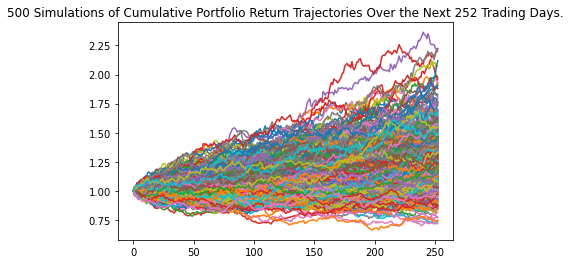

In [443]:
# Visualize the 30-year Monte Carlo simulation by creating an
# overlay line plot
MC_sim_line_plot = MC_1year.plot_simulation()
MC_sim_line_plot.get_figure().savefig("MC_1year.png", bbox_inches="tight")

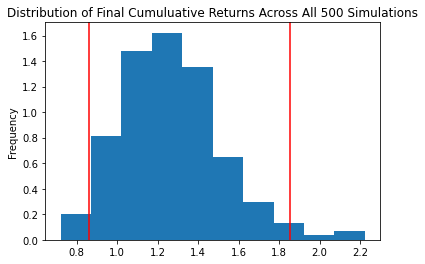

In [444]:
# Visualize the probability distribution of the 1-year Monte Carlo simulation 
# by plotting a histogram
MC_sim_hist = MC_1year.plot_distribution()

In [445]:
MC_sim_hist.get_figure().savefig('MC_sim_hist.png',bbox_inches='tight')

In [446]:
# Generate summary statistics from the 1-year Monte Carlo simulation results
# Save the results as a variable
MC_1_sum_stats = MC_1year.summarize_cumulative_return()

# Review the 1-year Monte Carlo summary statistics
print(MC_1_sum_stats)

count           500.000000
mean              1.271606
std               0.248733
min               0.719494
25%               1.095463
50%               1.247633
75%               1.417314
max               2.223889
95% CI Lower      0.861348
95% CI Upper      1.854673
Name: 252, dtype: float64


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:172: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [447]:
# Configure the Monte Carlo simulation to forecast 5 year cumulative returns
# The weights are generated by the portfolio optimization.
# Run 500 samples.
# Review the simulation input data
MC_5year = MCSimulation(
    portfolio_data = df_pf_4,
    weights = [.00317653, .06630845, .30034533, .17904461, .45112508],
    num_simulation = 1000,
    num_trading_days= 252*5
)
MC_5year.portfolio_data.tail()

CMG                  HLT                  LOW               \
              close daily_return   close daily_return   close daily_return   
2022-07-26  1316.43    -0.009361  120.22    -0.016122  188.60    -0.031828   
2022-07-27  1510.00     0.147042  129.25     0.075112  189.92     0.006999   
2022-07-28  1538.88     0.019126  128.00    -0.009671  190.80     0.004634   
2022-07-29  1564.22     0.016467  128.07     0.000547  191.53     0.003826   
2022-08-01  1557.38    -0.004373  128.69     0.004841  194.09     0.013366   

               SPY                 TSLA               
             close daily_return   close daily_return  
2022-07-26  776.58    -0.035664  390.89    -0.011831  
2022-07-27  824.46     0.061655  401.04     0.025966  
2022-07-28  842.70     0.022124  406.07     0.012542  
2022-07-29  891.45     0.057850  411.99     0.014579  
2022-08-01  891.83     0.000426  410.77    -0.002961

In [448]:
MC_5year.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 110.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 120.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 130.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 140.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 150.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 160.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 170.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 180.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 190.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 200.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 210.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 220.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 230.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 240.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 250.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 260.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 270.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 280.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 290.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 300.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 310.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 320.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 330.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 340.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 350.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 360.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 370.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 380.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 390.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 400.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 410.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 420.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 430.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 440.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 450.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 460.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 470.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 480.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 490.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 500.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 510.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 520.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 530.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 540.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 550.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 560.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 570.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 580.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 590.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 600.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 610.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 620.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 630.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 640.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 650.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 660.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 670.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 680.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 690.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 700.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 710.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 720.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 730.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 740.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 750.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 760.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 770.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 780.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 790.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 800.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 810.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 820.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 830.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 840.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 850.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 860.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 870.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 880.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 890.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 900.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 910.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 920.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 930.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 940.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 950.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 960.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 970.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 980.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 990.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.992249,1.001460,1.014621,0.970927,0.989343,0.993387,0.993073,1.016141,1.008336,1.023253,...,1.008399,0.980080,1.002651,0.976661,0.998306,1.009771,1.000923,0.999114,0.972052,1.003422
2,1.000303,1.000243,1.019736,0.975633,0.996673,0.998216,0.992101,1.049196,0.998066,1.042051,...,1.022382,0.964581,1.012338,0.975682,0.983656,1.005992,1.000693,1.026711,0.954450,1.004583
3,1.015176,0.992006,1.018446,0.978949,0.997120,0.995510,0.977295,1.066735,1.019089,1.046855,...,1.023046,0.964807,1.012640,0.975927,0.998970,1.013686,0.989146,1.040590,0.945004,1.006368
4,1.046984,0.997595,1.031461,0.976864,0.982804,1.003338,0.988221,1.064250,1.036073,1.043255,...,1.037152,0.965960,1.021901,0.978305,0.998787,1.001878,0.987749,1.046194,0.936253,1.026636
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,3.836099,2.284728,1.988386,4.059651,4.865946,2.326897,2.055538,3.125979,5.734971,3.209581,...,3.297258,4.214538,2.948384,2.504480,4.804951,2.887538,2.966747,4.227299,2.346579,1.678421
1257,3.923368,2.271975,1.984283,4.092319,4.977081,2.333700,2.060910,3.164782,5.689996,3.170256,...,3.287967,4.148155,2.945792,2.489945,4.779663,2.923081,2.943889,4.261604,2.375123,1.715022
1258,3.936997,2.317563,1.996775,4.135360,4.958288,2.352288,2.069786,3.196482,5.775948,3.122519,...,3.302416,4.122385,2.907420,2.510398,4.811310,2.888809,2.915537,4.198915,2.380214,1.722979
1259,4.028979,2.345031,2.020851,4.140882,4.971583,2.369593,2.104237,3.249470,5.824200,3.177646,...,3.326734,4.193573,2.913187,2.475014,4.896569,2.892148,2.894871,4.204828,2.418062,1.686483


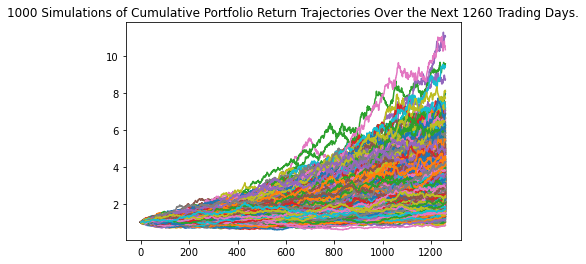

In [449]:
# Visualize the 5-year Monte Carlo simulation by creating an
# overlay line plot
MC_sim_line_plot_5y = MC_5year.plot_simulation()
MC_sim_line_plot_5y.get_figure().savefig("MC_5year.png", bbox_inches="tight")

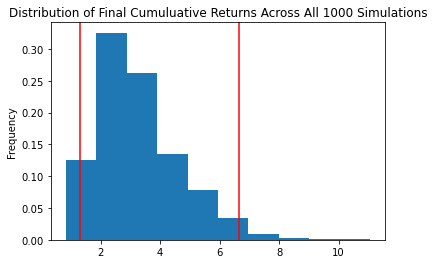

In [450]:
# Visualize the probability distribution of the 5-year Monte Carlo simulation 
# by plotting a histogram
MC_sim_hist_5y = MC_5year.plot_distribution()

In [451]:
# Generate summary statistics from the 5-year Monte Carlo simulation results
# Save the results as a variable
MC_5_sum_stats = MC_5year.summarize_cumulative_return()

# Review the 5-year Monte Carlo summary statistics
print(MC_5_sum_stats)

count           1000.000000
mean               3.282283
std                1.422911
min                0.832523
25%                2.272475
50%                2.984421
75%                3.998134
max               11.058632
95% CI Lower       1.316709
95% CI Upper       6.639894
Name: 1260, dtype: float64


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:172: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [453]:
# Configure the Monte Carlo simulation to forecast 1 year cumulative returns
# The weights are generated by the portfolio optimization.
# Run 500 samples.
# Review the simulation input data
MC_5year_init = MCSimulation(
    portfolio_data = df_pf_4,
    weights = [.1, .3, .05, .05, .5],
    num_simulation = 1000,
    num_trading_days= 252*5
)
MC_5year_init.portfolio_data.tail()

CMG                  HLT                  LOW               \
              close daily_return   close daily_return   close daily_return   
2022-07-26  1316.43    -0.009361  120.22    -0.016122  188.60    -0.031828   
2022-07-27  1510.00     0.147042  129.25     0.075112  189.92     0.006999   
2022-07-28  1538.88     0.019126  128.00    -0.009671  190.80     0.004634   
2022-07-29  1564.22     0.016467  128.07     0.000547  191.53     0.003826   
2022-08-01  1557.38    -0.004373  128.69     0.004841  194.09     0.013366   

               SPY                 TSLA               
             close daily_return   close daily_return  
2022-07-26  776.58    -0.035664  390.89    -0.011831  
2022-07-27  824.46     0.061655  401.04     0.025966  
2022-07-28  842.70     0.022124  406.07     0.012542  
2022-07-29  891.45     0.057850  411.99     0.014579  
2022-08-01  891.83     0.000426  410.77    -0.002961

In [454]:
MC_5year_init.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 110.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 120.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 130.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 140.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 150.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 160.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 170.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 180.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 190.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 200.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 210.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 220.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 230.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 240.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 250.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 260.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 270.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 280.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 290.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 300.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 310.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 320.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 330.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 340.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 350.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 360.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 370.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 380.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 390.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 400.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 410.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 420.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 430.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 440.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 450.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 460.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 470.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 480.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 490.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 500.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 510.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 520.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 530.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 540.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 550.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 560.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 570.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 580.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 590.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 600.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 610.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 620.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 630.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 640.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 650.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 660.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 670.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 680.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 690.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 700.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 710.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 720.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 730.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 740.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 750.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 760.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 770.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 780.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 790.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 800.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 810.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 820.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 830.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 840.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 850.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 860.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 870.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 880.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 890.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 900.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 910.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 920.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 930.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 940.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 950.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 960.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 970.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 980.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 990.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.997384,1.004906,1.014036,0.998206,1.009813,0.999293,1.011065,0.996916,0.990089,0.988534,...,1.006936,0.989999,0.988876,1.023243,1.003342,0.991587,1.015515,0.997583,0.992326,1.000847
2,1.003819,0.990143,1.014208,1.005904,1.012203,1.019242,1.007337,1.004832,1.015083,0.997195,...,1.010889,0.977913,0.983650,1.016792,1.003082,0.987689,0.986974,0.984742,0.998667,1.002909
3,1.006378,0.982116,1.035504,1.002343,1.008879,1.016208,1.009062,1.002321,1.006121,0.991355,...,1.014336,0.972347,0.991038,1.006145,1.007172,0.993899,0.991998,0.977419,1.001166,1.001754
4,0.996112,0.973334,1.030963,1.001177,0.988727,1.016736,1.013277,1.004876,1.006003,1.010854,...,1.015597,0.980663,1.015187,0.990783,1.004938,0.998022,1.003561,0.972370,1.005535,0.996916
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,4.241615,2.842786,2.000892,3.190087,2.965272,3.542043,2.699225,2.279658,2.684958,2.162705,...,1.597940,2.961685,1.205041,2.432320,2.353563,1.669317,3.597792,2.642389,2.095373,1.422657
1257,4.265448,2.871541,1.979523,3.254648,2.961963,3.633994,2.686467,2.290430,2.671332,2.114285,...,1.577992,2.975686,1.187787,2.432649,2.384982,1.708636,3.624844,2.642242,2.081607,1.433630
1258,4.281869,2.892144,1.988352,3.279867,2.954745,3.645927,2.659644,2.290801,2.698661,2.112452,...,1.581826,2.983096,1.182580,2.436330,2.404206,1.718175,3.564463,2.659657,2.120884,1.433775
1259,4.271872,2.863189,1.975774,3.306272,2.959163,3.679763,2.675248,2.296370,2.694430,2.116400,...,1.567986,2.980200,1.189009,2.487582,2.416979,1.710995,3.609340,2.672824,2.147639,1.443834


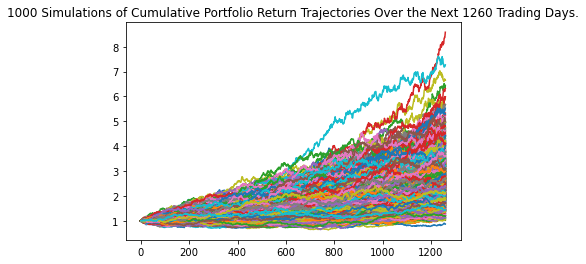

In [455]:
# Visualize the 5-year Monte Carlo simulation by creating an
# overlay line plot
MC_sim_line_plot_5y_init = MC_5year_init.plot_simulation()
MC_sim_line_plot_5y_init.get_figure().savefig("MC_5year.png", bbox_inches="tight")

In [456]:
# Generate summary statistics from the 5-year Monte Carlo simulation results
# Save the results as a variable
MC_5_sum_stats_init = MC_5year_init.summarize_cumulative_return()

# Review the 5-year Monte Carlo summary statistics
print(MC_5_sum_stats_init)

count           1000.000000
mean               2.684668
std                0.930534
min                0.866734
25%                2.007168
50%                2.532528
75%                3.187885
max                8.584166
95% CI Lower       1.279777
95% CI Upper       4.903145
Name: 1260, dtype: float64


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:172: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



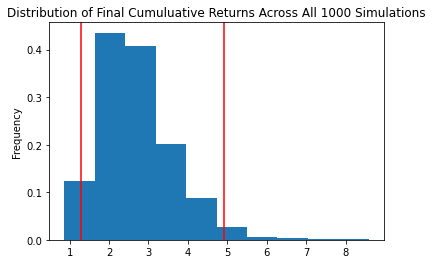

In [457]:
# Visualize the probability distribution of the 5-year Monte Carlo simulation 
# by plotting a histogram
MC_sim_hist_5y_init = MC_5year_init.plot_distribution()

In [458]:
MC_1year_init = MCSimulation(
    portfolio_data = df_pf_4,
    weights = [.1, .3, .05, .05, .5],
    num_simulation = 500,
    num_trading_days= 252
)
MC_1year_init.portfolio_data.tail()

CMG                  HLT                  LOW               \
              close daily_return   close daily_return   close daily_return   
2022-07-26  1316.43    -0.009361  120.22    -0.016122  188.60    -0.031828   
2022-07-27  1510.00     0.147042  129.25     0.075112  189.92     0.006999   
2022-07-28  1538.88     0.019126  128.00    -0.009671  190.80     0.004634   
2022-07-29  1564.22     0.016467  128.07     0.000547  191.53     0.003826   
2022-08-01  1557.38    -0.004373  128.69     0.004841  194.09     0.013366   

               SPY                 TSLA               
             close daily_return   close daily_return  
2022-07-26  776.58    -0.035664  390.89    -0.011831  
2022-07-27  824.46     0.061655  401.04     0.025966  
2022-07-28  842.70     0.022124  406.07     0.012542  
2022-07-29  891.45     0.057850  411.99     0.014579  
2022-08-01  891.83     0.000426  410.77    -0.002961

In [459]:
MC_1year_init.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 230.
Running Monte Carlo simulation number 240.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 250.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 260.
Running Monte Carlo simulation number 270.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 280.
Running Monte Carlo simulation number 290.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 300.
Running Monte Carlo simulation number 310.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 320.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 330.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 340.
Running Monte Carlo simulation number 350.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 360.
Running Monte Carlo simulation number 370.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 380.
Running Monte Carlo simulation number 390.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 400.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 410.
Running Monte Carlo simulation number 420.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 430.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 440.
Running Monte Carlo simulation number 450.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 460.
Running Monte Carlo simulation number 470.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

Running Monte Carlo simulation number 480.
Running Monte Carlo simulation number 490.


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:117: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.002357,0.997298,1.003313,0.985283,1.012013,1.002199,1.002592,0.995711,1.007946,1.007054,...,1.003589,1.005928,1.002419,0.994303,1.002034,0.990944,0.980034,1.021859,0.994666,0.998654
2,0.994358,0.988734,1.012277,0.979837,1.026082,1.003769,1.002696,0.997995,1.007668,1.004105,...,1.014472,1.005343,1.006149,0.995798,1.009973,0.997095,0.974968,1.018472,0.989530,1.001190
3,0.987362,0.971509,1.025453,0.982302,1.026509,0.995578,1.020877,1.001645,1.012750,1.010209,...,1.018980,1.000188,1.000479,0.984914,1.019318,1.005515,0.978973,1.003985,0.995267,1.008397
4,0.996185,0.988138,1.032837,0.987999,1.018987,0.992533,1.024599,1.009405,1.002967,1.006737,...,1.016629,0.995709,0.993847,0.980062,1.022040,1.017328,1.000474,1.009924,1.009904,0.996063
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
248,1.423878,0.945084,1.745370,1.261529,0.794135,1.275105,1.432514,1.049477,1.284575,1.084614,...,1.161820,1.307038,1.164942,1.259488,1.090912,1.050022,1.602884,1.414604,1.194662,1.104178
249,1.449762,0.958817,1.764569,1.262032,0.787273,1.269651,1.435257,1.058000,1.284311,1.081067,...,1.157397,1.330518,1.167429,1.282480,1.093153,1.044949,1.602727,1.413154,1.195473,1.105121
250,1.447864,0.967660,1.753340,1.293364,0.788310,1.270375,1.443892,1.066068,1.275748,1.073364,...,1.140149,1.351689,1.155447,1.267388,1.098713,1.051364,1.627186,1.405245,1.215394,1.111195
251,1.457474,0.982279,1.761340,1.314053,0.793203,1.309820,1.457471,1.068367,1.274070,1.080303,...,1.131588,1.345926,1.154048,1.267151,1.109797,1.041409,1.611724,1.403841,1.214690,1.110885


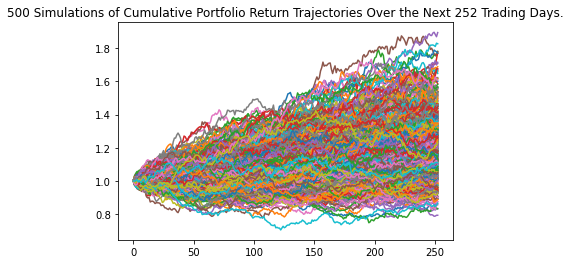

In [461]:
# Visualize the 1-year Monte Carlo simulation by creating an
# overlay line plot
MC_sim_line_plot_1y_init = MC_1year_init.plot_simulation()
MC_sim_line_plot_1y_init.get_figure().savefig("MC_1year_init.png", bbox_inches="tight")

In [462]:
# Generate summary statistics from the 1-year Monte Carlo simulation results
# Save the results as a variable
MC_1_sum_stats_init = MC_1year_init.summarize_cumulative_return()

# Review the 1-year Monte Carlo summary statistics
print(MC_1_sum_stats_init)

count           500.000000
mean              1.221597
std               0.193586
min               0.793317
25%               1.078374
50%               1.198896
75%               1.341152
max               1.893410
95% CI Lower      0.895817
95% CI Upper      1.654095
Name: 252, dtype: float64


/Users/mikecutno/Documents/GitHub/Stock_Project/MCForecastTools.py:172: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



Our original model had a mean return of 1.22 over 1 year, and our optimized model returned 1.27 over the same time period. The two methods of generating the best weights were both based off of finding the highest sharpe ratios, but slightly different results were returned. One model used randomization (VectorBT), while the other used a for loop to iterate through the weights. One key difference was rebalancing the portfolio monthly nfor further optimization. We were able to do that in VectorBT, but if we had to iterate through all of those calculations it would be a huge strain on computational load. 

Next we will like to explore how machine learning can further enhance our approach to portfolio optimization and forecasting. 